# **Libraries**

In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import numpy as np
import time
import openpyxl
from textwrap import wrap, fill

from sklearn.linear_model import LinearRegression
from sklearn.experimental import enable_iterative_imputer
from sklearn.impute import IterativeImputer
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score, recall_score, classification_report, ConfusionMatrixDisplay
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV
from sklearn.neural_network import MLPClassifier
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from xgboost import XGBClassifier

import warnings
warnings.filterwarnings("ignore")

# **Project's Part 1** (Short Version)

In [2]:
# Loading the train dataset
df = pd.read_csv('Xy_train.csv')

# Renaming a column with long name and unusual format
df.rename(columns={'Departure/Arrival time convenient': 'Timing convenient'}, inplace=True)

# Converting column data types
categorical_columns = df.columns[[0, 1, 3, 4, 6]]
likert_columns = df.columns[list(range(7, 19))]
df[categorical_columns] = df[categorical_columns].astype('category')
df[likert_columns] = df[likert_columns].astype('Int64')

# Drop records with 25%+ Nulls
df.dropna(thresh=0.75 * len(df.columns), inplace=True)

# Drop 100% useless column
df.drop(columns=['Plane colors'], inplace=True)

# Fill Null-infested discrete column with the column's mode
df['Leg room service'].fillna(df['Leg room service'].mode()[0], inplace=True)

# Fill Null-infested continous column using linear regression of 0.96 correlated column
imputer = IterativeImputer(estimator=LinearRegression())
df.loc[:, ['Departure Delay in Minutes', 'Arrival Delay in Minutes']] = imputer.fit_transform(df.loc[:, ['Departure Delay in Minutes', 'Arrival Delay in Minutes']])

# Replace invalid values with the column's median or mode
invalid_conditions = {
    'Gate location': df['Gate location'] == 999,
    'Class': df['Class'] == "IT IS SO BORING WORKING IN AN AIRPORT'S DESK OH MY GODDDDD",

    'Age': (df['Age'] > 120) | (df['Age'] <= 0),
    'Flight Distance': (df['Flight Distance'] < 0) | (df['Flight Distance'] > 25000),
    'Departure Delay in Minutes': df['Departure Delay in Minutes'] < 0,
    'Arrival Delay in Minutes': df['Arrival Delay in Minutes'] < 0
}
for column, condition in invalid_conditions.items():
    df.loc[condition, column] = np.nan
for column in invalid_conditions.keys():
  if (df[column].dtype == 'category') | (df[column].dtype == 'Int64'):
        mode_value = df[column].mode().iloc[0]
        df[column].fillna(mode_value, inplace=True)
  else:
        median_value = df[column].median()
        df[column].fillna(median_value, inplace=True)
df['Class'] = df['Class'].cat.remove_unused_categories()

# # Discretization
# age_bins = [0, 18, 40, 60, np.inf]
# age_labels = ['0-18', '19-40', '41-60', '61+']
# distance_bins = [0, 500, 1500, 2500, np.inf]
# distance_labels = ['0-500', '500-1500', '1500-2500', '2500+']
# delay_bins = [-np.inf, 0, 15, 30, 60, np.inf]
# delay_labels = ['0', '1-15', '16-30', '31-60', '61+']
# df['Age_Binned'] = pd.cut(df['Age'], bins=age_bins, labels=age_labels, include_lowest=True)
# df['Flight_Distance_Binned'] = pd.cut(df['Flight Distance'], bins=distance_bins, labels=distance_labels, include_lowest=True)
# df['Departure_Delay_in_Minutes_Binned'] = pd.cut(df['Departure Delay in Minutes'], bins=delay_bins, labels=delay_labels, include_lowest=True)
# df['Arrival_Delay_in_Minutes_Binned'] = pd.cut(df['Arrival Delay in Minutes'], bins=delay_bins, labels=delay_labels, include_lowest=True)

# Add 2 derived columns
df['Overall Service Rating'] = df['On-board service'] + df['Inflight service'] + df['Baggage handling'] + df['Checkin service']
df['Convenience Rating'] = df['Inflight wifi service'] + df['Food and drink'] + df['Seat comfort'] + df['Leg room service']

# **Machine Learning Pre-Processing** - Binarization & Split

Binarization of columns:

In [3]:
# df.replace({'sex': {'female': True, 'male': False}}, inplace=True)
df.replace({'Gender': {'Female': 0, 'Male': 1}}, inplace=True)
df.replace({'Customer Type': {'disloyal Customer': 0, 'Loyal Customer': 1}}, inplace=True)
df.replace({'Type of Travel': {'Personal Travel': 0, 'Business travel': 1}}, inplace=True)
df.replace({'satisfaction': {'neutral or dissatisfied': 0, 'satisfied': 1}}, inplace=True)

df = pd.get_dummies(df, columns=['Class'], dtype='int')

In [4]:
df.head(10).T

,0,1,2,3,4,5,6,7,8,9
Gender,0,0,1,1,1,1,1,1,0,0
Customer Type,1,1,0,0,1,1,1,1,1,1
Age,35.0,35.0,43.0,21.0,39.0,17.0,51.0,14.0,66.0,38.0
Type of Travel,0,1,1,1,0,1,1,0,1,1
Flight Distance,731.0,354.0,719.0,772.0,618.0,396.0,909.0,726.0,533.0,3113.0
Inflight wifi service,4,3,2,2,4,1,4,1,5,5
Timing convenient,3,3,2,2,2,5,5,1,5,5
Ease of Online booking,1,3,2,2,4,4,5,1,5,1
Gate location,4,3,5,2,2,3,5,3,5,5
Food and drink,3,3,4,2,2,1,3,5,4,5


In [5]:
features = df.drop(columns=['satisfaction']).columns
target = ['satisfaction']

X = df[features].values
y = df[target].values

Let's create an holdout split.

We'll pick 1000 records just like in X_test.csv and maintain the common rule of thumb 80/10/10 split.

In [6]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=1000, random_state=42)
# , stratify=y)

In [7]:
print(f"Train shape: {X_train.shape}")
print(f"Test shape: {X_test.shape}")

Train shape: (7998, 25)
Test shape: (1000, 25)


In [8]:
# print("Train\n--------\n", pd.value_counts(y_train)/y_train.shape[0], "\n\n")
# print("Test\n--------\n", pd.value_counts(y_test)/y_test.shape[0])

In [9]:
# Standard-Scale the data (for MLP Models)
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [10]:
def run_grid(estimator, param_grid, X, y, scoring='f1', cv=10, verbose=3):
    grid_search = GridSearchCV(estimator=estimator,
                               param_grid=param_grid,
                               scoring=scoring,
                               cv=cv,
                               verbose=verbose)
    start_time = time.time()
    grid_search.fit(X, y)
    
    runtime = time.time() - start_time
    results = pd.DataFrame(grid_search.cv_results_)
    best_model = grid_search.best_estimator_
    
    print(f"\nBest Parameters:\n {best_model.get_params()}")
    print(f"\nGridSearch Runtime: {runtime:.2f} seconds")

    return results, best_model

In [12]:
def evaluate_model(model, Xtrain, ytrain, Xtest, ytest):
    model_params = model.get_params()
    default_params = model.__class__().get_params()
    explicit_params = {k: v for k, v in model_params.items() if v != default_params[k]}

    train_preds = model.predict(Xtrain)
    test_preds = model.predict(Xtest)
    
    print(f"{type(model).__name__} with non-default parameters set {explicit_params}:")
    print(f"Train F1: {f1_score(y_train, train_preds):.5f}")
    print(f"Test F1: {f1_score(y_test, test_preds):.5f}\n")

# **Decision Tree** - Default

We'll start with a full tree

In [12]:
# Baseline
model = DecisionTreeClassifier(random_state=42)

In [13]:
model.fit(X_train, y_train)

DecisionTreeClassifier(random_state=42)

[Text(0.4230769230769231, 0.875, 'Type of Travel <= 0.5\ngini = 0.492\nsamples = 7998\nvalue = [4515, 3483]'),
 Text(0.15384615384615385, 0.625, 'Inflight wifi service <= 0.5\ngini = 0.185\nsamples = 2412\nvalue = [2163, 249]'),
 Text(0.28846153846153844, 0.75, 'True  '),
 Text(0.07692307692307693, 0.375, 'gini = 0.0\nsamples = 52\nvalue = [0, 52]'),
 Text(0.23076923076923078, 0.375, 'Inflight wifi service <= 4.5\ngini = 0.153\nsamples = 2360\nvalue = [2163, 197]'),
 Text(0.15384615384615385, 0.125, '\n  (...)  \n'),
 Text(0.3076923076923077, 0.125, '\n  (...)  \n'),
 Text(0.6923076923076923, 0.625, 'Customer Type <= 0.5\ngini = 0.488\nsamples = 5586\nvalue = [2352, 3234]'),
 Text(0.5576923076923077, 0.75, '  False'),
 Text(0.5384615384615384, 0.375, 'Inflight wifi service <= 3.5\ngini = 0.353\nsamples = 1414\nvalue = [1090, 324]'),
 Text(0.46153846153846156, 0.125, '\n  (...)  \n'),
 Text(0.6153846153846154, 0.125, '\n  (...)  \n'),
 Text(0.8461538461538461, 0.375, 'Overall Service Ra

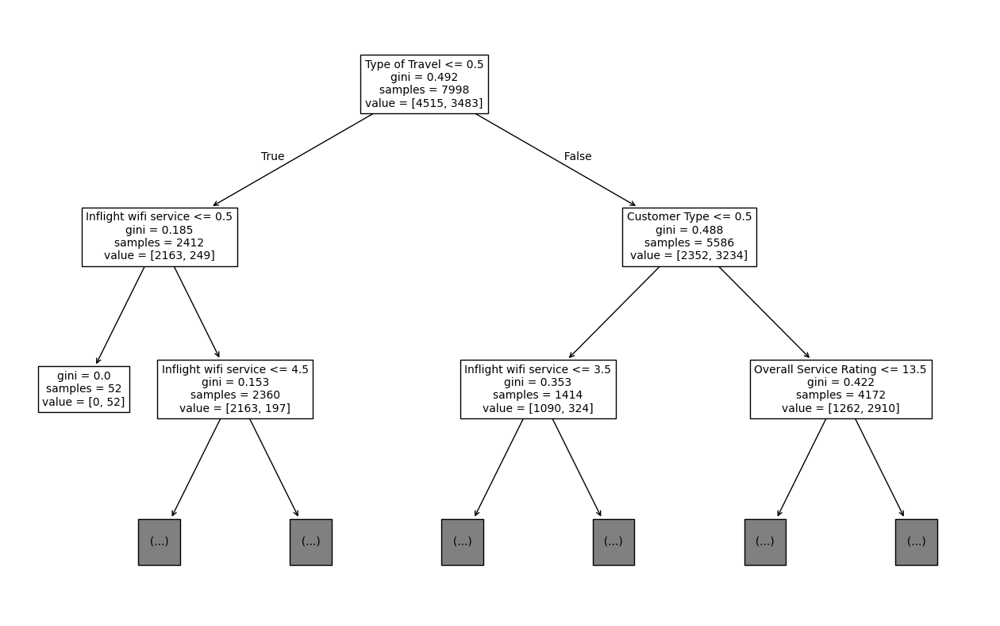

In [14]:
plt.figure(figsize=(16, 10))
plot_tree(model, max_depth=2, fontsize=10, feature_names=df.drop(columns='satisfaction').columns)

In [15]:
# print(f"Train accuracy: {accuracy_score(y_train, model.predict(X_train)):.4}")
# print(f"Test accuracy: {accuracy_score(y_test, model.predict(X_test)):.4}")
# print()
print(f"Train F1: {f1_score(y_train, model.predict(X_train)):.4}")
print(f"Test F1: {f1_score(y_test, model.predict(X_test)):.4}")

Train F1: 1.0
Test F1: 0.8595


In [16]:
model.get_depth()

20

# **Decision Tree** - max_depth

In [34]:
grid_dt_max_depth, best_dt_max_depth_model = run_grid(DecisionTreeClassifier(random_state=42),
                                                      param_grid={'max_depth': np.arange(1, 71, 1)},
                                                      X=X_train,
                                                      y=y_train
                                               )

Fitting 10 folds for each of 70 candidates, totalling 700 fits
[CV 1/10] END ......................max_depth=1;, score=0.721 total time=   0.0s
[CV 2/10] END ......................max_depth=1;, score=0.715 total time=   0.0s
[CV 3/10] END ......................max_depth=1;, score=0.720 total time=   0.0s
[CV 4/10] END ......................max_depth=1;, score=0.727 total time=   0.0s
[CV 5/10] END ......................max_depth=1;, score=0.703 total time=   0.0s
[CV 6/10] END ......................max_depth=1;, score=0.704 total time=   0.0s
[CV 7/10] END ......................max_depth=1;, score=0.709 total time=   0.0s
[CV 8/10] END ......................max_depth=1;, score=0.704 total time=   0.0s
[CV 9/10] END ......................max_depth=1;, score=0.709 total time=   0.0s
[CV 10/10] END .....................max_depth=1;, score=0.720 total time=   0.0s
[CV 1/10] END ......................max_depth=2;, score=0.791 total time=   0.0s
[CV 2/10] END ......................max_depth=

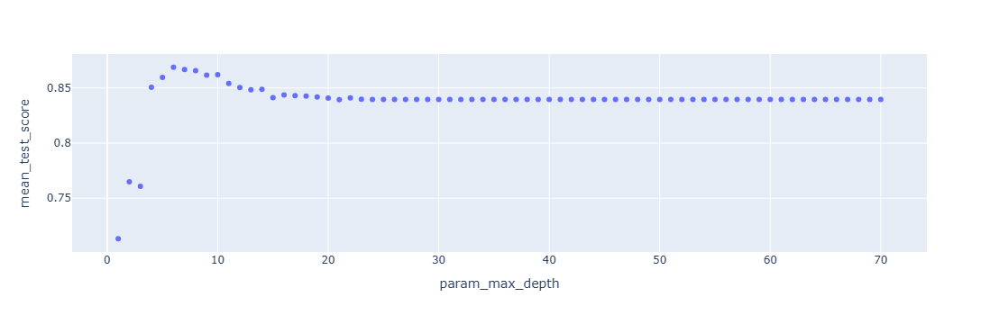

In [35]:
px.scatter(grid_dt_max_depth,
           x='param_max_depth',
           y='mean_test_score',
           width=600
          )

# **Decision Tree** - criterion, max_features, max_depth

In [36]:
grid_dt_criterion_max_features_max_depth, best_dt_criterion_max_features_max_depth_model = run_grid(DecisionTreeClassifier(random_state=42),
                                                                                                    param_grid={
                                                                                                        'max_depth': np.arange(1, 31, 1),
                                                                                                        'criterion': ['entropy', 'gini'],
                                                                                                        'max_features': ['sqrt', 'log2', None]},
                                                                                                    X=X_train,
                                                                                                    y=y_train)

Fitting 10 folds for each of 180 candidates, totalling 1800 fits
[CV 1/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.721 total time=   0.0s
[CV 2/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.715 total time=   0.0s
[CV 3/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.720 total time=   0.0s
[CV 4/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.727 total time=   0.0s
[CV 5/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.703 total time=   0.0s
[CV 6/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.704 total time=   0.0s
[CV 7/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.709 total time=   0.0s
[CV 8/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.704 total time=   0.0s
[CV 9/10] END criterion=entropy, max_depth=1, max_features=sqrt;, score=0.709 total time=   0.0s
[CV 10/10] END criterion=entropy, max_depth=1, max_features=sq

In [113]:
evaluate_model(best_dt_criterion_max_features_max_depth_model, X_train, y_train, X_test, y_test)

DecisionTreeClassifier with non-default parameters set {'max_depth': 6, 'random_state': 42}:
Train F1: 0.87682
Test F1: 0.87691



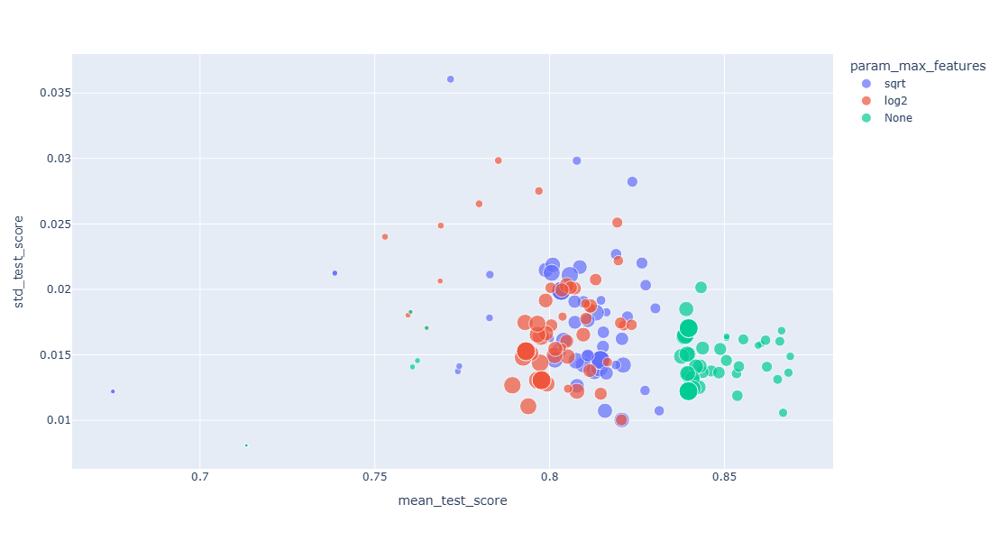

In [114]:
grid_dt_criterion_max_features_max_depth['param_max_features'] = grid_dt_criterion_max_features_max_depth['param_max_features'].astype(str)
grid_dt_criterion_max_features_max_depth['param_max_depth'] = grid_dt_criterion_max_features_max_depth['param_max_depth'].astype(int)

px.scatter(grid_dt_criterion_max_features_max_depth,
           x='mean_test_score',
           y='std_test_score',
           size='param_max_depth',
           # color='param_criterion',
           color='param_max_features',
           hover_data=['param_max_features', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

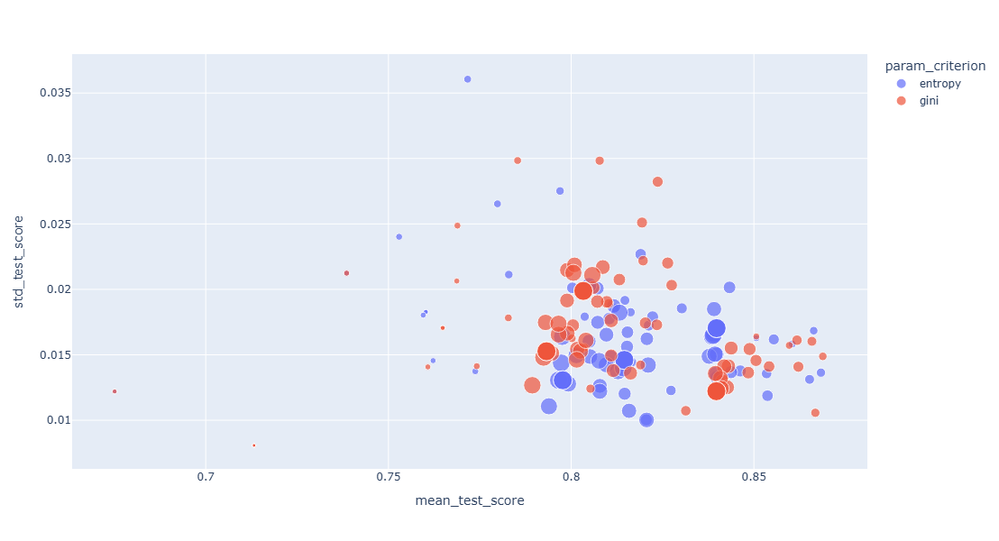

In [115]:
px.scatter(grid_dt_criterion_max_features_max_depth,
           x='mean_test_score',
           y='std_test_score',
           size='param_max_depth',
           color='param_criterion',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

In [18]:
best1 = DecisionTreeClassifier(criterion='gini', max_depth=6, max_features=None, random_state=42)
best2 = DecisionTreeClassifier(criterion='entropy', max_depth=7, max_features=None, random_state=42)
best3 = DecisionTreeClassifier(criterion='gini', max_depth=7, max_features=None, random_state=42)

best1.fit(X_train, y_train)
best2.fit(X_train, y_train)
best3.fit(X_train, y_train)

evaluate_model(best1, X_train, y_train, X_test, y_test)
evaluate_model(best2, X_train, y_train, X_test, y_test)
evaluate_model(best3, X_train, y_train, X_test, y_test)

DecisionTreeClassifier with non-default parameters set {'max_depth': 6, 'random_state': 42}:
Train F1: 0.87682
Test F1: 0.87691

DecisionTreeClassifier with non-default parameters set {'criterion': 'entropy', 'max_depth': 7, 'random_state': 42}:
Train F1: 0.89028
Test F1: 0.90151

DecisionTreeClassifier with non-default parameters set {'max_depth': 7, 'random_state': 42}:
Train F1: 0.89184
Test F1: 0.89895



DT best2 it is.

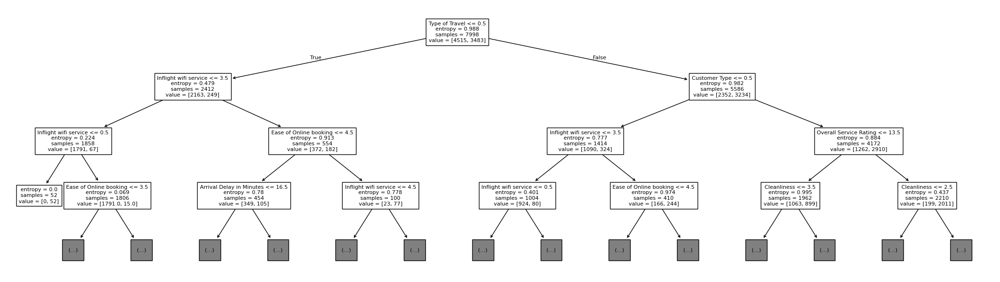

In [136]:
plt.figure(figsize=(21, 6))
plot_tree(best2, max_depth=3, fontsize=8, feature_names=features)
plt.tight_layout()

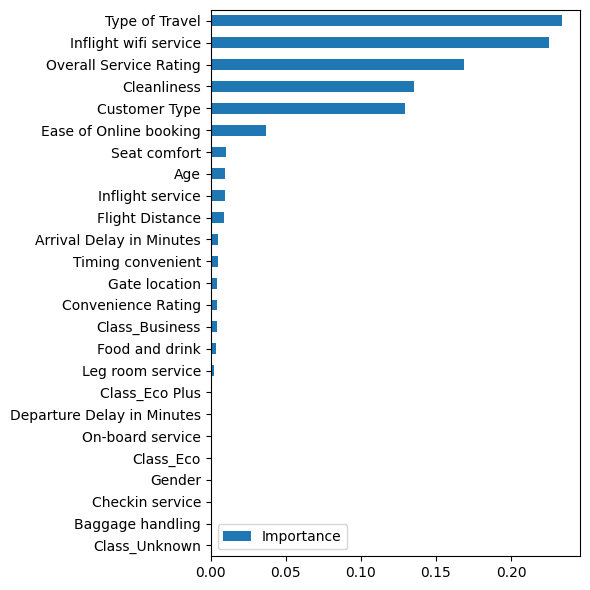

In [139]:
feat_importances = pd.DataFrame(best2.feature_importances_, index=df.drop(columns='satisfaction').columns, columns=["Importance"])
feat_importances.sort_values(by='Importance', ascending=False, inplace=True)
feat_importances.plot(kind='barh', figsize=(6,6))
plt.gca().invert_yaxis()
plt.tight_layout()

# **Decision Tree** - ccp_alpha

In [141]:
ccp_alphas = DecisionTreeClassifier(random_state=42).cost_complexity_pruning_path(X_train, y_train).ccp_alphas

grid_dt_alpha, best_dt_alpha_model = run_grid(DecisionTreeClassifier(random_state=42),
                                              param_grid={'ccp_alpha': ccp_alphas},
                                              X=X_train,
                                              y=y_train)

Fitting 10 folds for each of 350 candidates, totalling 3500 fits
[CV 1/10] END ....................ccp_alpha=0.0;, score=0.850 total time=   0.0s
[CV 2/10] END ....................ccp_alpha=0.0;, score=0.821 total time=   0.0s
[CV 3/10] END ....................ccp_alpha=0.0;, score=0.851 total time=   0.0s
[CV 4/10] END ....................ccp_alpha=0.0;, score=0.839 total time=   0.0s
[CV 5/10] END ....................ccp_alpha=0.0;, score=0.818 total time=   0.0s
[CV 6/10] END ....................ccp_alpha=0.0;, score=0.847 total time=   0.0s
[CV 7/10] END ....................ccp_alpha=0.0;, score=0.834 total time=   0.0s
[CV 8/10] END ....................ccp_alpha=0.0;, score=0.842 total time=   0.0s
[CV 9/10] END ....................ccp_alpha=0.0;, score=0.858 total time=   0.0s
[CV 10/10] END ...................ccp_alpha=0.0;, score=0.839 total time=   0.0s
[CV 1/10] END ..ccp_alpha=6.123979974585485e-05;, score=0.850 total time=   0.0s
[CV 2/10] END ..ccp_alpha=6.123979974585485e

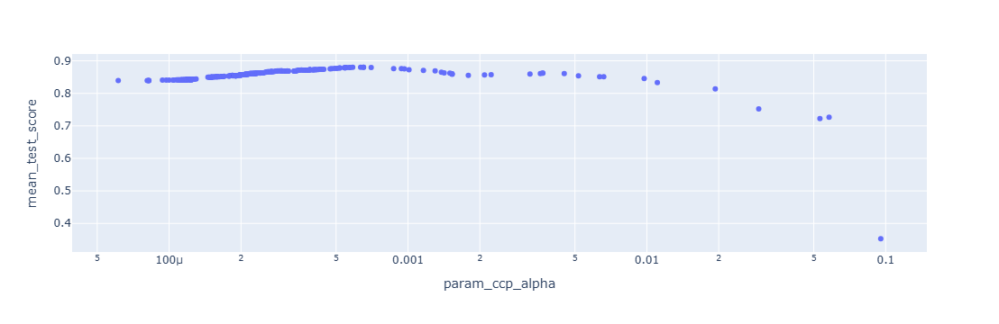

In [142]:
px.scatter(grid_results_tree_2,
           x='param_ccp_alpha',
           y='mean_test_score',
           width=600,
           log_x=True
          )

# **Decision Tree** - * (criterion, max_features, ccp_alpha)

In [46]:
ccp_alphas = DecisionTreeClassifier(random_state=42).cost_complexity_pruning_path(X_train, y_train).ccp_alphas

grid_dt_criterion_max_features_alpha, best_dt_criterion_max_features_alpha_model = run_grid(DecisionTreeClassifier(random_state=42),
                                                                                            param_grid={
                                                                                                'criterion': ['entropy', 'gini'],
                                                                                                'max_features': ['sqrt', 'log2', None],
                                                                                                'ccp_alpha': ccp_alphas},
                                                                                            X=X_train,
                                                                                            y=y_train)

Fitting 10 folds for each of 2100 candidates, totalling 21000 fits
[CV 1/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.833 total time=   0.0s
[CV 2/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.791 total time=   0.0s
[CV 3/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.833 total time=   0.0s
[CV 4/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.806 total time=   0.0s
[CV 5/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.803 total time=   0.0s
[CV 6/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.808 total time=   0.0s
[CV 7/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.809 total time=   0.0s
[CV 8/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.829 total time=   0.0s
[CV 9/10] END ccp_alpha=0.0, criterion=entropy, max_features=sqrt;, score=0.831 total time=   0.0s
[CV 10/10] END ccp_alpha=0.0, criterion=en

In [47]:
grid_dt_criterion_max_features_alpha[
['rank_test_score','param_criterion','param_max_features','param_ccp_alpha','mean_test_score','std_test_score']].sort_values('rank_test_score').head(30)

,rank_test_score,param_criterion,param_max_features,param_ccp_alpha,mean_test_score,std_test_score
1901,1,gini,None,0.000634,0.880262,0.012273
1913,2,gini,None,0.000651,0.879969,0.012166
1907,2,gini,None,0.000651,0.879969,0.012166
1895,4,gini,None,0.000587,0.879953,0.013305
1883,5,gini,None,0.000568,0.879576,0.013572
1889,5,gini,None,0.000573,0.879576,0.013572
1919,7,gini,None,0.000701,0.879514,0.012995
1877,8,gini,None,0.000552,0.879431,0.013029
1859,9,gini,None,0.000544,0.878969,0.013504
1871,10,gini,None,0.000547,0.878819,0.013092


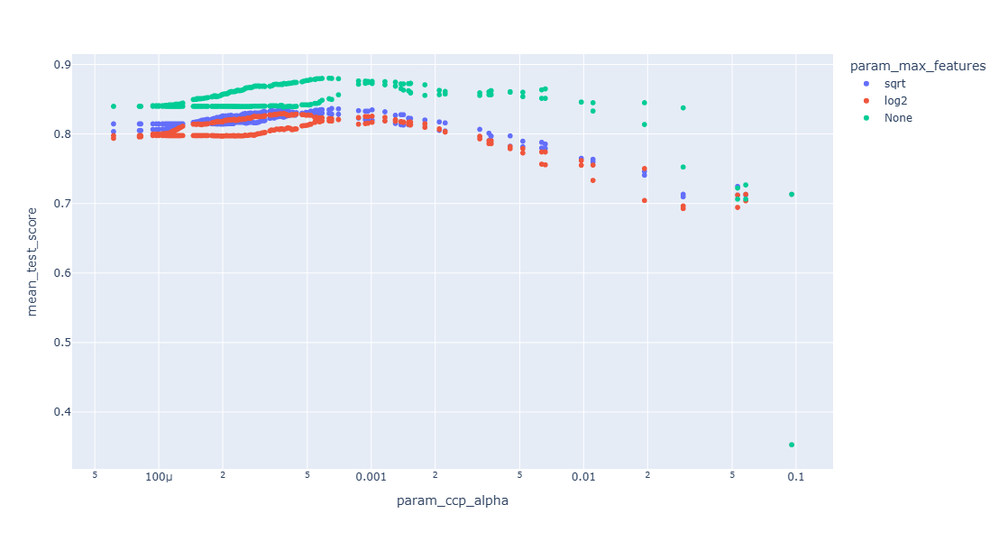

In [146]:
grid_dt_criterion_max_features_alpha['param_max_features'] = grid_dt_criterion_max_features_alpha['param_max_features'].astype(str)
grid_dt_criterion_max_features_alpha['param_ccp_alpha'] = grid_dt_criterion_max_features_alpha['param_ccp_alpha'].astype(float)

px.scatter(grid_dt_criterion_max_features_alpha,
           x='param_ccp_alpha',
           y='mean_test_score',
           # size='param_max_depth',
           # color='param_criterion',
           color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           log_x=True,
           size_max=15,
           width=800,
           height=600)

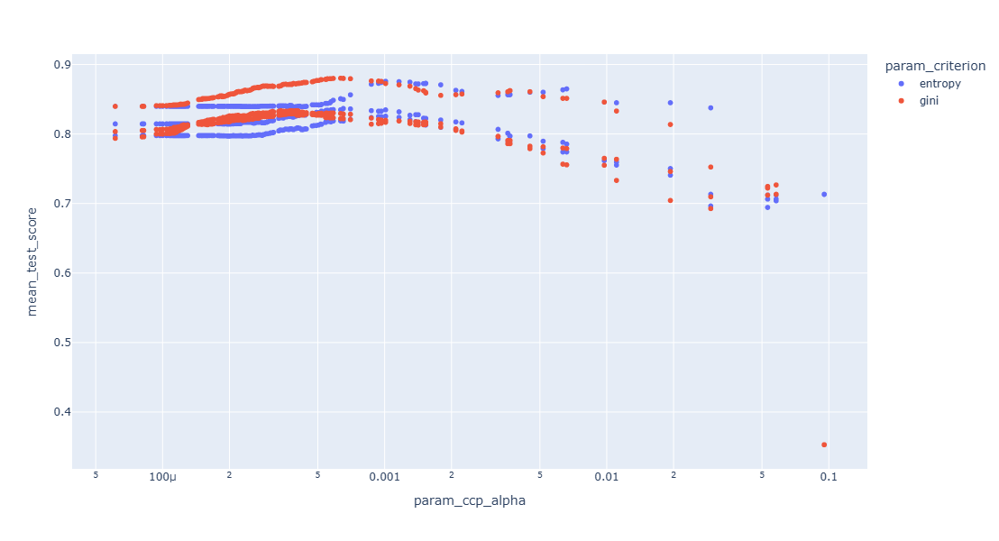

In [147]:
px.scatter(grid_dt_criterion_max_features_alpha,
           x='param_ccp_alpha',
           y='mean_test_score',
           # size='param_max_depth',
           color='param_criterion',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           log_x=True,
           size_max=15,
           width=800,
           height=600)

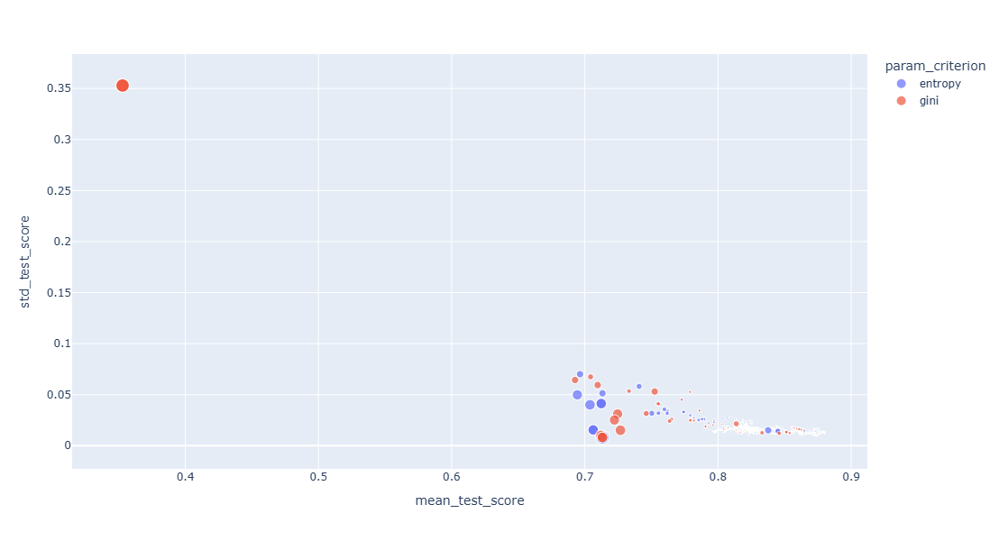

In [148]:
px.scatter(grid_dt_criterion_max_features_alpha,
           x='mean_test_score',
           y='std_test_score',
           size='param_ccp_alpha',
           color='param_criterion',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

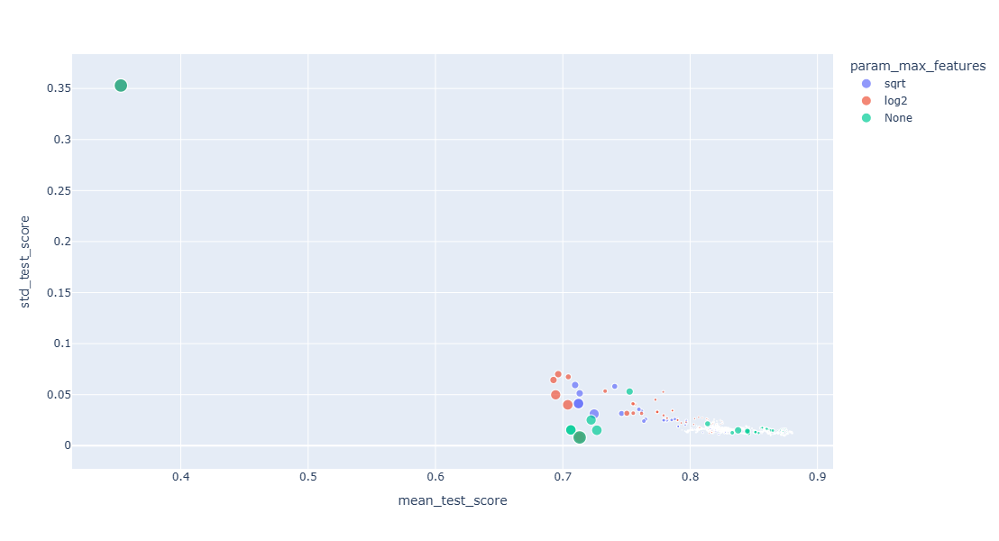

In [149]:
px.scatter(grid_dt_criterion_max_features_alpha,
           x='mean_test_score',
           y='std_test_score',
           size='param_ccp_alpha',
           color='param_max_features',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

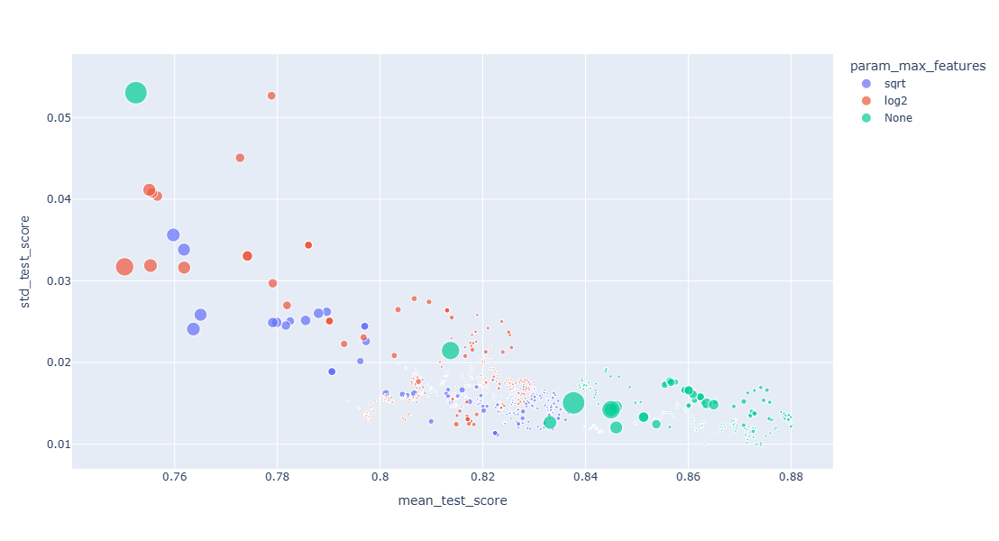

In [150]:
px.scatter(grid_dt_criterion_max_features_alpha[grid_dt_criterion_max_features_alpha['mean_test_score'] > 0.75],
           x='mean_test_score',
           y='std_test_score',
           size='param_ccp_alpha',
           color='param_max_features',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           size_max=25,
           width=800,
           height=600)

Let's zoom in on values with mean test score > 0.85

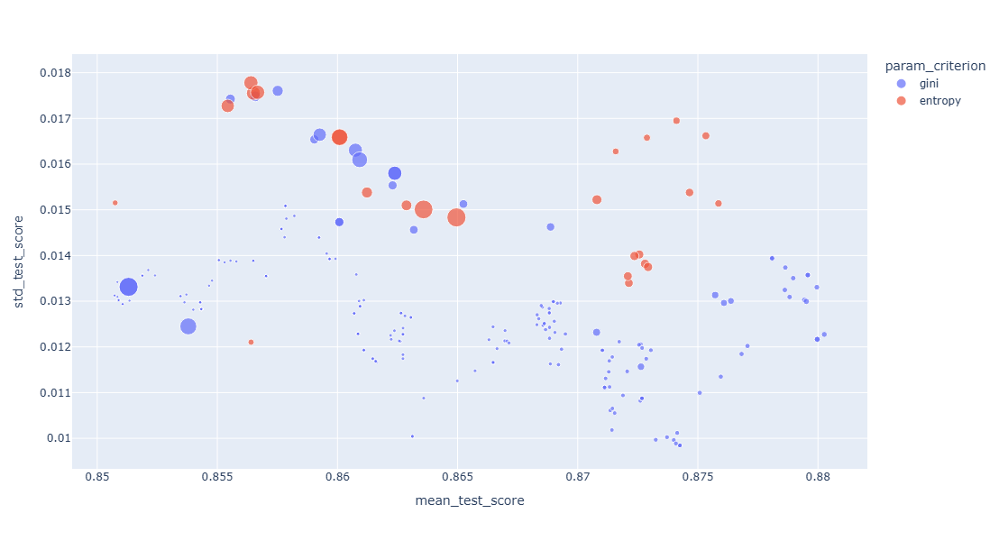

In [152]:
px.scatter(grid_dt_criterion_max_features_alpha[grid_dt_criterion_max_features_alpha['mean_test_score'] > 0.85],
           x='mean_test_score',
           y='std_test_score',
           size='param_ccp_alpha',
           color='param_criterion',
           # color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

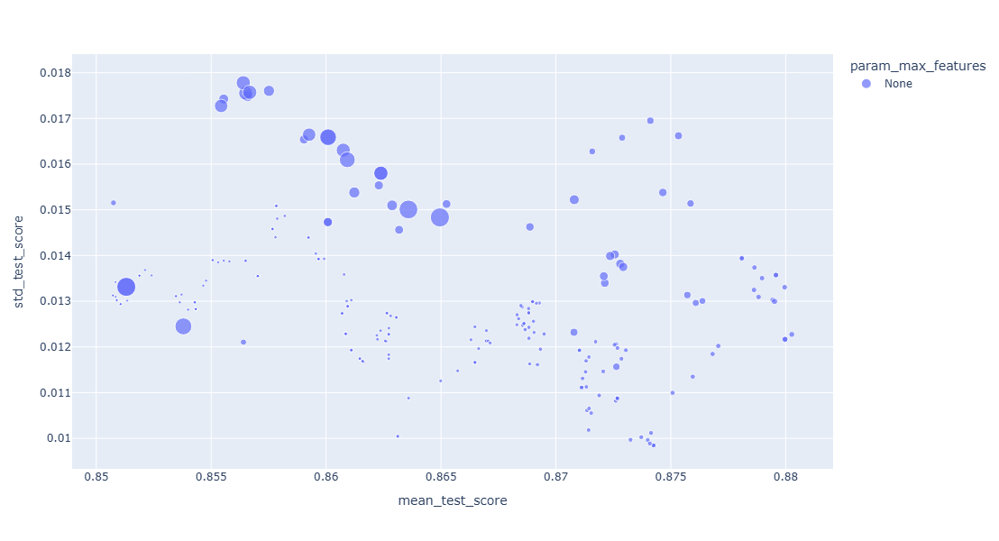

In [153]:
px.scatter(grid_dt_criterion_max_features_alpha[grid_dt_criterion_max_features_alpha['mean_test_score'] > 0.85],
           x='mean_test_score',
           y='std_test_score',
           size='param_ccp_alpha',
           # color='param_criterion',
           color='param_max_features',
           hover_data=['param_max_features', 'param_ccp_alpha', 'param_criterion'],
           size_max=15,
           width=800,
           height=600)

In [144]:
print(f"Best model's depth: {best_dt_criterion_max_features_alpha_model.get_depth()}")
evaluate_model(best_dt_criterion_max_features_alpha_model, X_train, y_train, X_test, y_test)

Best model's depth: 10
DecisionTreeClassifier with non-default parameters set {'ccp_alpha': 0.00063356340877334, 'random_state': 42}:
Train F1: 0.89048
Test F1: 0.90536



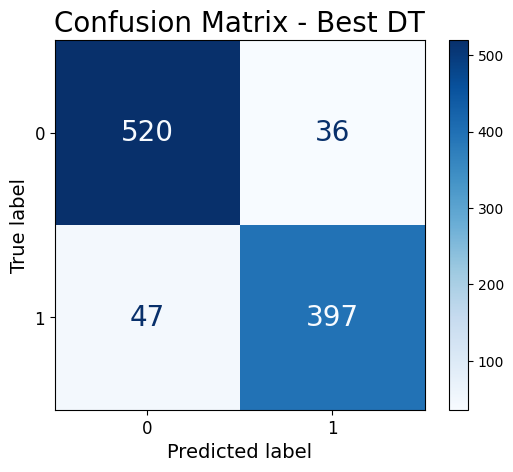

In [49]:
# Assuming y_test and model.predict(X_test_scaled) are already defined
cm = confusion_matrix(y_test, best_dt_criterion_max_features_alpha_model.predict(X_test))
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
ax = disp.plot(cmap=plt.cm.Blues)

# Set the font size of the labels
ax.ax_.set_xlabel('Predicted label', fontsize=14)
ax.ax_.set_ylabel('True label', fontsize=14)
ax.ax_.set_title('Confusion Matrix - Best DT', fontsize=20)

# Set the font size of the tick labels
ax.ax_.tick_params(axis='both', which='major', labelsize=12)

# Adjust the font size of the text inside the plot
for text in ax.ax_.texts:
    text.set_fontsize(20)

plt.show()

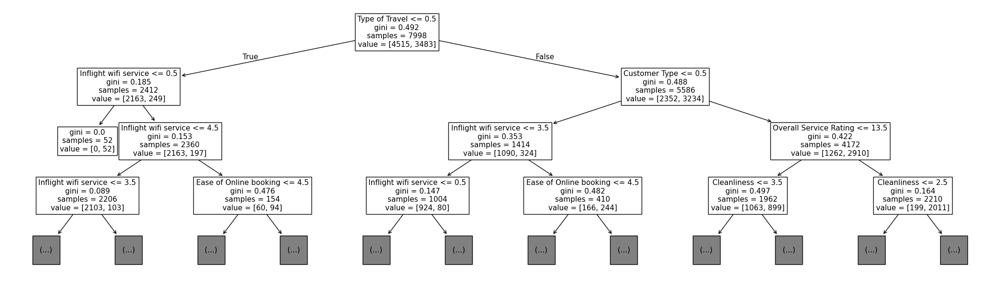

In [154]:
plt.figure(figsize=(21, 6))
plot_tree(best_dt_criterion_max_features_alpha_model, max_depth=3, fontsize=11, feature_names=features)
plt.tight_layout()
# plt.savefig("best_alpha_tree.png")

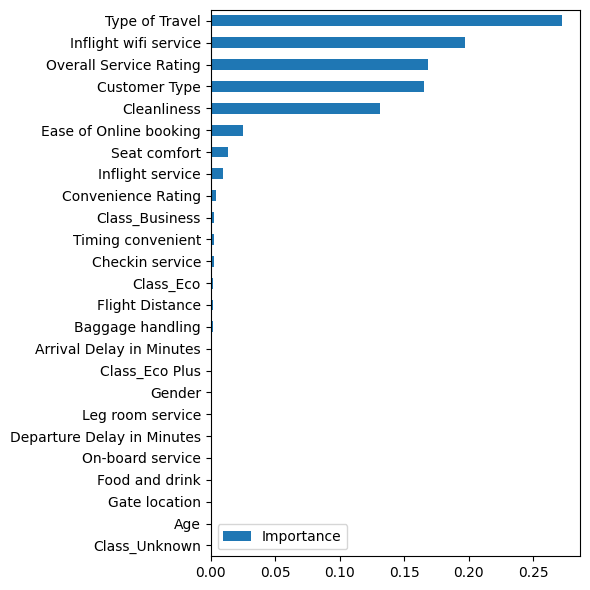

In [155]:
feat_importances = pd.DataFrame(best_dt_criterion_max_features_alpha_model.feature_importances_,
                                index=df.drop(columns='satisfaction').columns,
                                columns=["Importance"])
feat_importances.sort_values(by='Importance', ascending=False, inplace=True)
feat_importances.plot(kind='barh', figsize=(6,6))
plt.gca().invert_yaxis()
plt.tight_layout()
# plt.savefig("best_alpha_feature_importance.png")
# plt.gca().invert_xaxis()

# **MLP** - Default

In [43]:
model = MLPClassifier(random_state=42)
model.fit(X_train_scaled, y_train)

MLPClassifier(random_state=42)

In [94]:
evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

MLPClassifier with set parameters {'random_state': 42}:
Train F1: 0.94502
Test F1: 0.88132



In [47]:
model.get_params()
# model.get_metadata_routing()

{'activation': 'relu',
 'alpha': 0.0001,
 'batch_size': 'auto',
 'beta_1': 0.9,
 'beta_2': 0.999,
 'early_stopping': False,
 'epsilon': 1e-08,
 'hidden_layer_sizes': (100,),
 'learning_rate': 'constant',
 'learning_rate_init': 0.001,
 'max_fun': 15000,
 'max_iter': 200,
 'momentum': 0.9,
 'n_iter_no_change': 10,
 'nesterovs_momentum': True,
 'power_t': 0.5,
 'random_state': 42,
 'shuffle': True,
 'solver': 'adam',
 'tol': 0.0001,
 'validation_fraction': 0.1,
 'verbose': False,
 'warm_start': False}

# **MLP** - alpha

In [161]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(-3,3,0.2)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 30 candidates, totalling 300 fits
[CV 1/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 2/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 3/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 4/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 5/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 6/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 7/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 8/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 9/10] END .........................alpha=-3.0;, score=nan total time=   0.0s
[CV 10/10] END ........................alpha=-3.0;, score=nan total time=   0.0s
[CV 1/10] END .........................alpha=-2.8;, score=nan total time=   0.0s
[CV 2/10] END .........................alpha=-

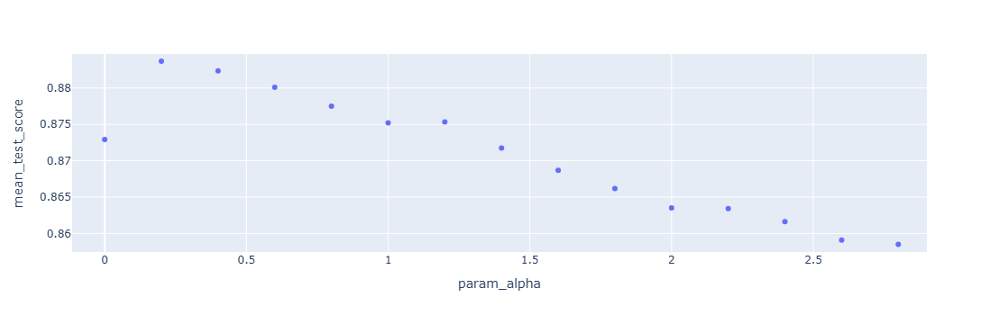

In [162]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600)

In [163]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0,1,0.02)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 50 candidates, totalling 500 fits
[CV 1/10] END ........................alpha=0.0;, score=0.896 total time=   3.3s
[CV 2/10] END ........................alpha=0.0;, score=0.857 total time=   3.3s
[CV 3/10] END ........................alpha=0.0;, score=0.873 total time=   3.3s
[CV 4/10] END ........................alpha=0.0;, score=0.900 total time=   3.4s
[CV 5/10] END ........................alpha=0.0;, score=0.836 total time=   3.4s
[CV 6/10] END ........................alpha=0.0;, score=0.862 total time=   3.3s
[CV 7/10] END ........................alpha=0.0;, score=0.863 total time=   3.5s
[CV 8/10] END ........................alpha=0.0;, score=0.879 total time=   3.3s
[CV 9/10] END ........................alpha=0.0;, score=0.893 total time=   3.3s
[CV 10/10] END .......................alpha=0.0;, score=0.869 total time=   3.3s
[CV 1/10] END .......................alpha=0.02;, score=0.895 total time=   3.4s
[CV 2/10] END .......................alpha=0.0

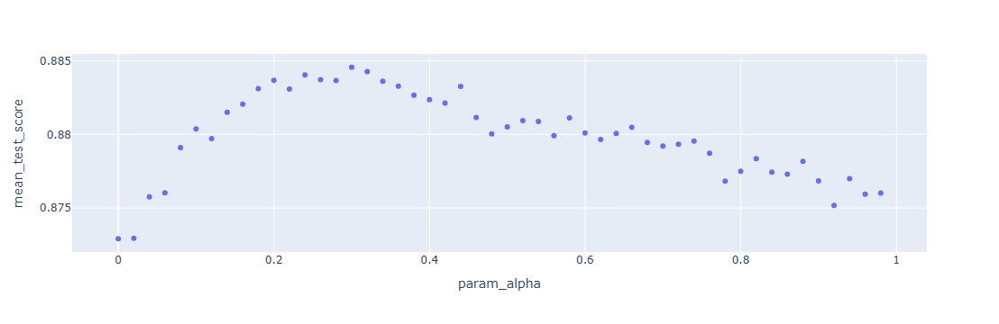

In [164]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

In [165]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0.1,0.5,0.01)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
[CV 1/10] END ........................alpha=0.1;, score=0.898 total time=   3.4s
[CV 2/10] END ........................alpha=0.1;, score=0.876 total time=   3.3s
[CV 3/10] END ........................alpha=0.1;, score=0.879 total time=   3.4s
[CV 4/10] END ........................alpha=0.1;, score=0.900 total time=   3.4s
[CV 5/10] END ........................alpha=0.1;, score=0.847 total time=   3.4s
[CV 6/10] END ........................alpha=0.1;, score=0.880 total time=   3.3s
[CV 7/10] END ........................alpha=0.1;, score=0.866 total time=   3.4s
[CV 8/10] END ........................alpha=0.1;, score=0.880 total time=   3.4s
[CV 9/10] END ........................alpha=0.1;, score=0.897 total time=   3.5s
[CV 10/10] END .......................alpha=0.1;, score=0.880 total time=   3.4s
[CV 1/10] END .......................alpha=0.11;, score=0.901 total time=   3.5s
[CV 2/10] END .......................alpha=0.1

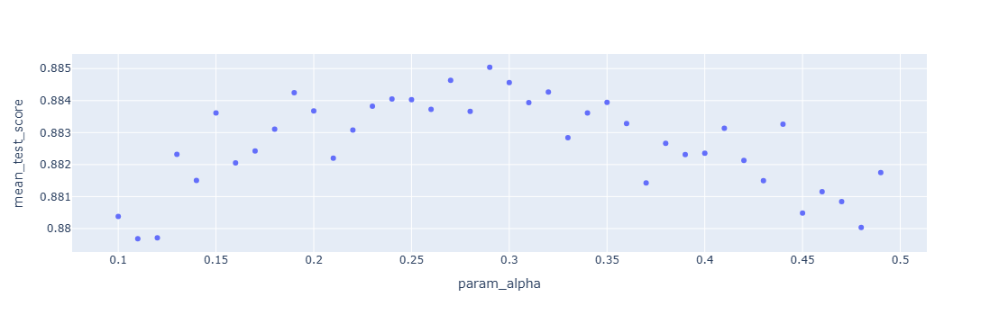

In [166]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

In [167]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0.12,0.38,0.0025)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 104 candidates, totalling 1040 fits
[CV 1/10] END .......................alpha=0.12;, score=0.904 total time=   3.2s
[CV 2/10] END .......................alpha=0.12;, score=0.876 total time=   3.2s
[CV 3/10] END .......................alpha=0.12;, score=0.878 total time=   3.2s
[CV 4/10] END .......................alpha=0.12;, score=0.896 total time=   3.2s
[CV 5/10] END .......................alpha=0.12;, score=0.836 total time=   3.2s
[CV 6/10] END .......................alpha=0.12;, score=0.878 total time=   3.2s
[CV 7/10] END .......................alpha=0.12;, score=0.865 total time=   3.2s
[CV 8/10] END .......................alpha=0.12;, score=0.880 total time=   3.2s
[CV 9/10] END .......................alpha=0.12;, score=0.896 total time=   3.2s
[CV 10/10] END ......................alpha=0.12;, score=0.887 total time=   3.2s
[CV 1/10] END .....................alpha=0.1225;, score=0.904 total time=   3.2s
[CV 2/10] END .....................alpha=0.1

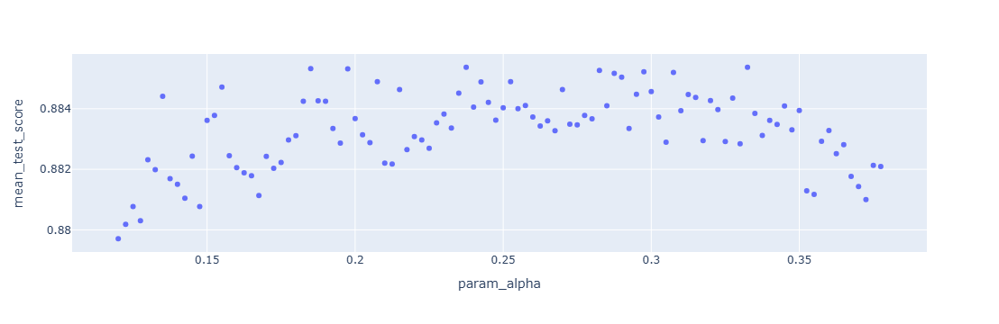

In [168]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

**In the summarized grid search, we'll iterate over alphas between 0.18 and 0.34** (0.1800, 0.1825 ... 0.3375, 0.3400)

# **MLP** - alpha (Default alpha (0.0001) area)

A look on multiplications of default alpha

In [12]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0.0001, 0.0011, 0.0001)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 10 candidates, totalling 100 fits
[CV 1/10] END .....................alpha=0.0001;, score=0.898 total time=   3.3s
[CV 2/10] END .....................alpha=0.0001;, score=0.857 total time=   3.2s
[CV 3/10] END .....................alpha=0.0001;, score=0.875 total time=   3.3s
[CV 4/10] END .....................alpha=0.0001;, score=0.904 total time=   3.4s
[CV 5/10] END .....................alpha=0.0001;, score=0.839 total time=   3.4s
[CV 6/10] END .....................alpha=0.0001;, score=0.863 total time=   3.5s
[CV 7/10] END .....................alpha=0.0001;, score=0.862 total time=   3.4s
[CV 8/10] END .....................alpha=0.0001;, score=0.871 total time=   3.3s
[CV 9/10] END .....................alpha=0.0001;, score=0.891 total time=   3.3s
[CV 10/10] END ....................alpha=0.0001;, score=0.872 total time=   3.3s
[CV 1/10] END .....................alpha=0.0002;, score=0.889 total time=   3.3s
[CV 2/10] END .....................alpha=0.000

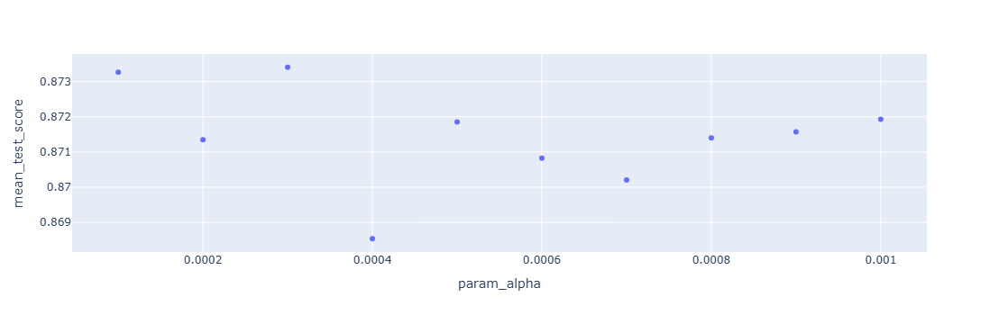

In [13]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

A look "around" default alpha

In [14]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0.00005, 0.00016, 0.00001)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 11 candidates, totalling 110 fits
[CV 1/10] END ......................alpha=5e-05;, score=0.896 total time=   3.4s
[CV 2/10] END ......................alpha=5e-05;, score=0.859 total time=   3.4s
[CV 3/10] END ......................alpha=5e-05;, score=0.877 total time=   3.4s
[CV 4/10] END ......................alpha=5e-05;, score=0.901 total time=   3.4s
[CV 5/10] END ......................alpha=5e-05;, score=0.831 total time=   3.5s
[CV 6/10] END ......................alpha=5e-05;, score=0.859 total time=   3.4s
[CV 7/10] END ......................alpha=5e-05;, score=0.858 total time=   3.4s
[CV 8/10] END ......................alpha=5e-05;, score=0.876 total time=   3.4s
[CV 9/10] END ......................alpha=5e-05;, score=0.896 total time=   3.4s
[CV 10/10] END .....................alpha=5e-05;, score=0.865 total time=   3.3s
[CV 1/10] END ......................alpha=6e-05;, score=0.896 total time=   3.3s
[CV 2/10] END ......................alpha=6e-0

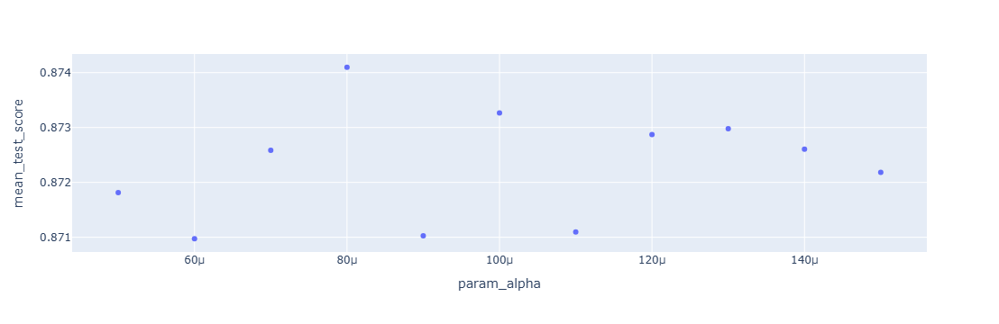

In [15]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

In [16]:
grid_mlp_alpha, best_mlp_alpha_model = run_grid(MLPClassifier(random_state=42),
                                                param_grid={'alpha':np.arange(0.00007, 0.00012, 0.000005)},
                                                X=X_train_scaled,
                                                y=y_train)

Fitting 10 folds for each of 11 candidates, totalling 110 fits
[CV 1/10] END ......................alpha=7e-05;, score=0.898 total time=   3.3s
[CV 2/10] END ......................alpha=7e-05;, score=0.859 total time=   3.4s
[CV 3/10] END ......................alpha=7e-05;, score=0.869 total time=   3.3s
[CV 4/10] END ......................alpha=7e-05;, score=0.901 total time=   3.3s
[CV 5/10] END ......................alpha=7e-05;, score=0.839 total time=   3.2s
[CV 6/10] END ......................alpha=7e-05;, score=0.864 total time=   3.2s
[CV 7/10] END ......................alpha=7e-05;, score=0.861 total time=   3.3s
[CV 8/10] END ......................alpha=7e-05;, score=0.871 total time=   3.2s
[CV 9/10] END ......................alpha=7e-05;, score=0.894 total time=   3.3s
[CV 10/10] END .....................alpha=7e-05;, score=0.870 total time=   3.3s
[CV 1/10] END ....................alpha=7.5e-05;, score=0.896 total time=   3.2s
[CV 2/10] END ....................alpha=7.5e-0

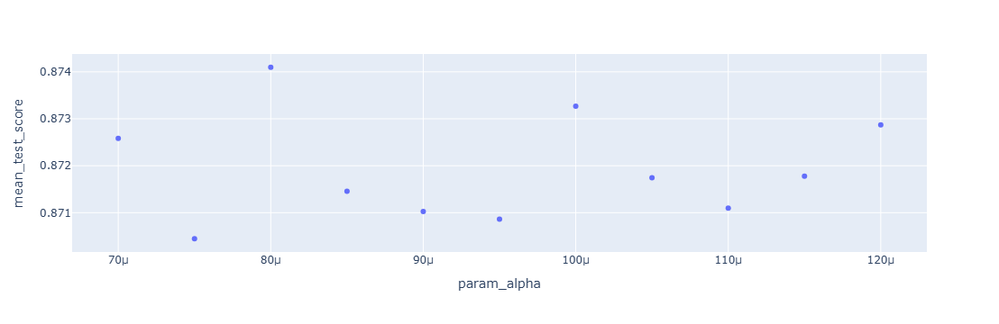

In [17]:
px.scatter(grid_mlp_alpha,
           x='param_alpha',
           y='mean_test_score',
           width=600
          )

# **MLP** - Learning Rate

In [18]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(-3,10,0.5)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 26 candidates, totalling 260 fits
[CV 1/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 2/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 3/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 4/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 5/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 6/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 7/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 8/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 9/10] END ............learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 10/10] END ...........learning_rate_init=-3.0;, score=nan total time=   0.0s
[CV 1/10] END ............learning_rate_init=-2.5;, score=nan total time=   0.0s
[CV 2/10] END ............learning_rate_init=-

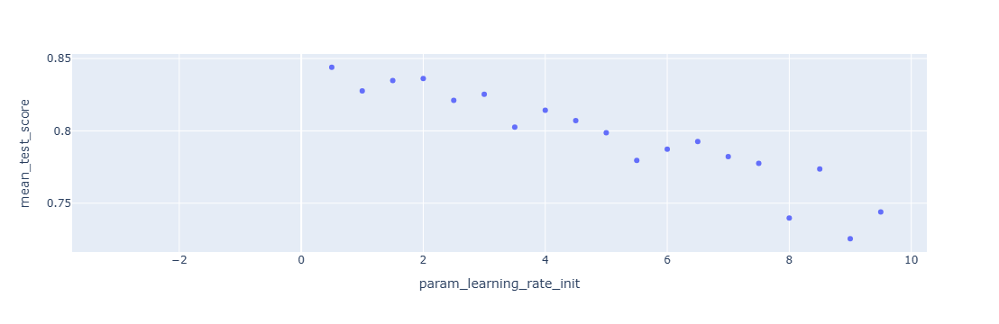

In [21]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

In [22]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(0,2,0.1)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[CV 1/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 2/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 3/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 4/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 5/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 6/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 7/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 8/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 9/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 10/10] END ............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 1/10] END ...........learning_rate_init=0.1;, score=0.891 total time=   0.8s
[CV 2/10] END ...........learning_rate_init=0.

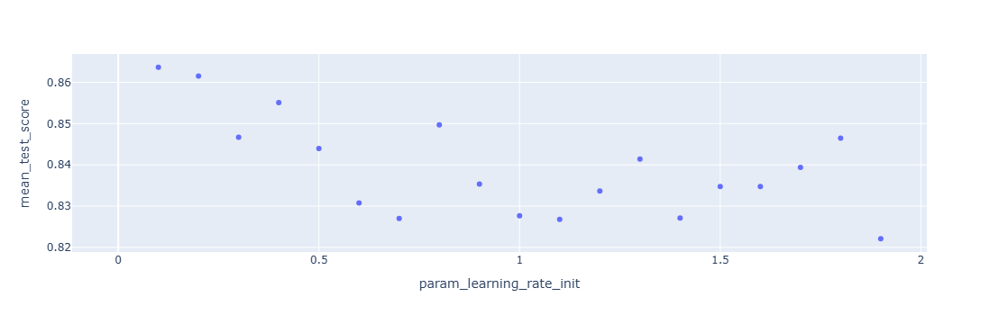

In [23]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

In [26]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(0,1,0.025)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 40 candidates, totalling 400 fits
[CV 1/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 2/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 3/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 4/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 5/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 6/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 7/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 8/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 9/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 10/10] END ............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 1/10] END .........learning_rate_init=0.025;, score=0.864 total time=   1.4s
[CV 2/10] END .........learning_rate_init=0.02

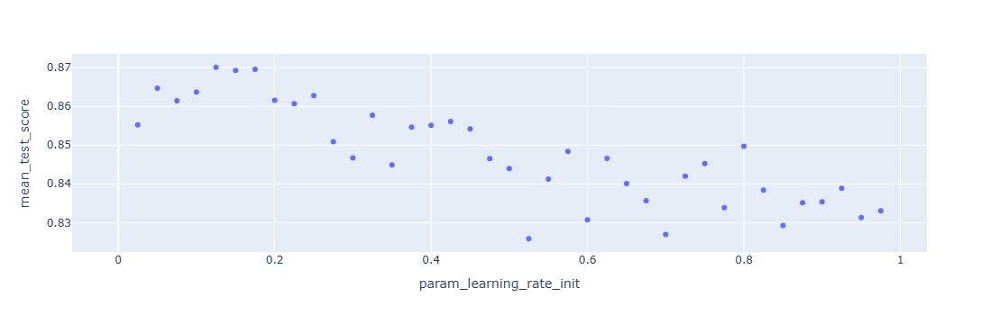

In [27]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

In [28]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(0,0.25,0.005)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 50 candidates, totalling 500 fits
[CV 1/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 2/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 3/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 4/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 5/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 6/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 7/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 8/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 9/10] END .............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 10/10] END ............learning_rate_init=0.0;, score=nan total time=   0.0s
[CV 1/10] END .........learning_rate_init=0.005;, score=0.868 total time=   3.2s
[CV 2/10] END .........learning_rate_init=0.00

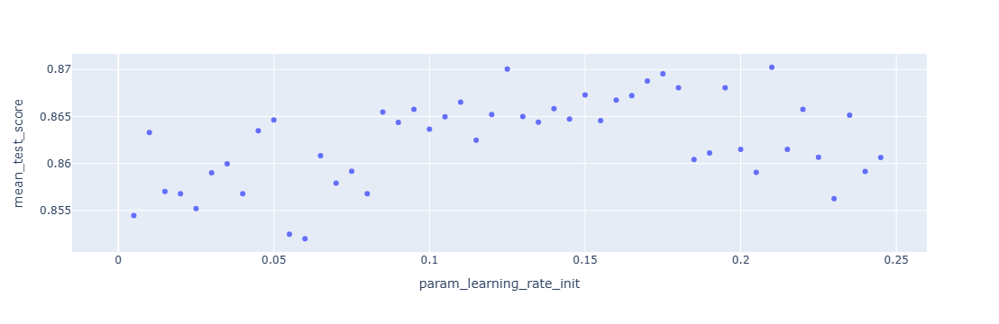

In [29]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

# **MLP** - Learning Rate (Default LR (0.001) area)

In [30]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': [0.1, 0.01, 0.001, 0.0001, 0.00001, 0.000001]},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 6 candidates, totalling 60 fits
[CV 1/10] END ...........learning_rate_init=0.1;, score=0.891 total time=   0.9s
[CV 2/10] END ...........learning_rate_init=0.1;, score=0.857 total time=   0.9s
[CV 3/10] END ...........learning_rate_init=0.1;, score=0.880 total time=   0.6s
[CV 4/10] END ...........learning_rate_init=0.1;, score=0.876 total time=   1.1s
[CV 5/10] END ...........learning_rate_init=0.1;, score=0.814 total time=   1.2s
[CV 6/10] END ...........learning_rate_init=0.1;, score=0.867 total time=   0.5s
[CV 7/10] END ...........learning_rate_init=0.1;, score=0.847 total time=   0.5s
[CV 8/10] END ...........learning_rate_init=0.1;, score=0.864 total time=   0.9s
[CV 9/10] END ...........learning_rate_init=0.1;, score=0.874 total time=   0.6s
[CV 10/10] END ..........learning_rate_init=0.1;, score=0.865 total time=   1.0s
[CV 1/10] END ..........learning_rate_init=0.01;, score=0.877 total time=   2.1s
[CV 2/10] END ..........learning_rate_init=0.01;

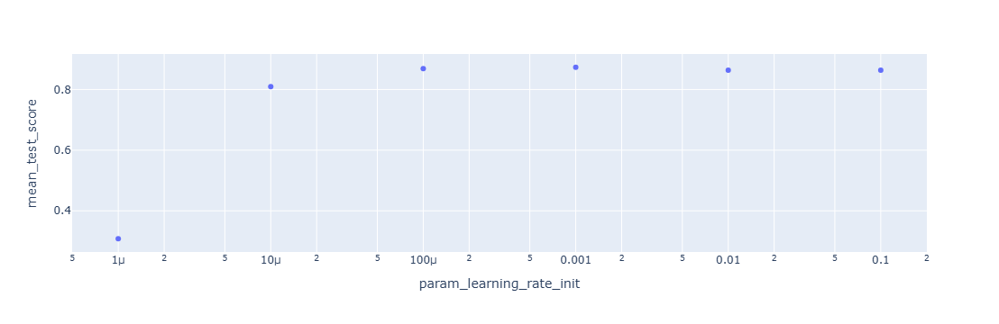

In [31]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600,
           log_x=True
          )

In [32]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(start=0.0001,stop=0.0021,step=0.0001)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[CV 1/10] END ........learning_rate_init=0.0001;, score=0.888 total time=   3.4s
[CV 2/10] END ........learning_rate_init=0.0001;, score=0.873 total time=   3.4s
[CV 3/10] END ........learning_rate_init=0.0001;, score=0.878 total time=   3.3s
[CV 4/10] END ........learning_rate_init=0.0001;, score=0.893 total time=   3.4s
[CV 5/10] END ........learning_rate_init=0.0001;, score=0.822 total time=   3.3s
[CV 6/10] END ........learning_rate_init=0.0001;, score=0.867 total time=   3.4s
[CV 7/10] END ........learning_rate_init=0.0001;, score=0.845 total time=   3.3s
[CV 8/10] END ........learning_rate_init=0.0001;, score=0.869 total time=   3.2s
[CV 9/10] END ........learning_rate_init=0.0001;, score=0.883 total time=   3.2s
[CV 10/10] END .......learning_rate_init=0.0001;, score=0.873 total time=   3.2s
[CV 1/10] END ........learning_rate_init=0.0002;, score=0.889 total time=   3.2s
[CV 2/10] END ........learning_rate_init=0.000

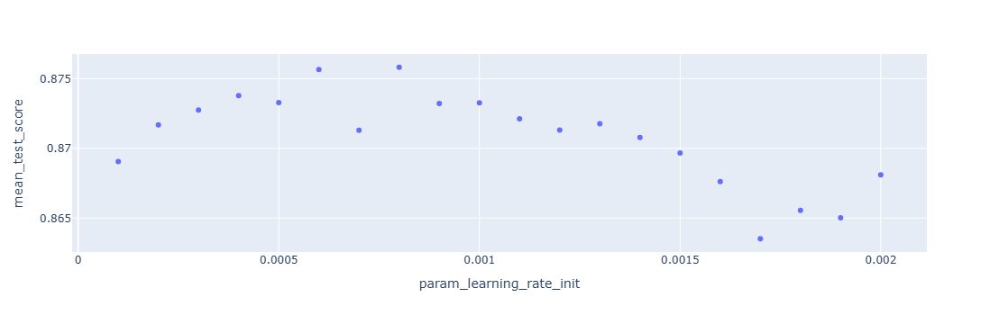

In [33]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

In [34]:
grid_mlp_lri, best_mlp_lri_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'learning_rate_init': np.arange(start=0.0005,stop=0.0011,step=0.000025)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 24 candidates, totalling 240 fits
[CV 1/10] END ........learning_rate_init=0.0005;, score=0.892 total time=   3.4s
[CV 2/10] END ........learning_rate_init=0.0005;, score=0.865 total time=   3.4s
[CV 3/10] END ........learning_rate_init=0.0005;, score=0.880 total time=   3.3s
[CV 4/10] END ........learning_rate_init=0.0005;, score=0.905 total time=   3.2s
[CV 5/10] END ........learning_rate_init=0.0005;, score=0.831 total time=   3.3s
[CV 6/10] END ........learning_rate_init=0.0005;, score=0.874 total time=   3.2s
[CV 7/10] END ........learning_rate_init=0.0005;, score=0.858 total time=   3.2s
[CV 8/10] END ........learning_rate_init=0.0005;, score=0.870 total time=   3.2s
[CV 9/10] END ........learning_rate_init=0.0005;, score=0.890 total time=   3.2s
[CV 10/10] END .......learning_rate_init=0.0005;, score=0.869 total time=   3.4s
[CV 1/10] END ......learning_rate_init=0.000525;, score=0.896 total time=   3.2s
[CV 2/10] END ......learning_rate_init=0.00052

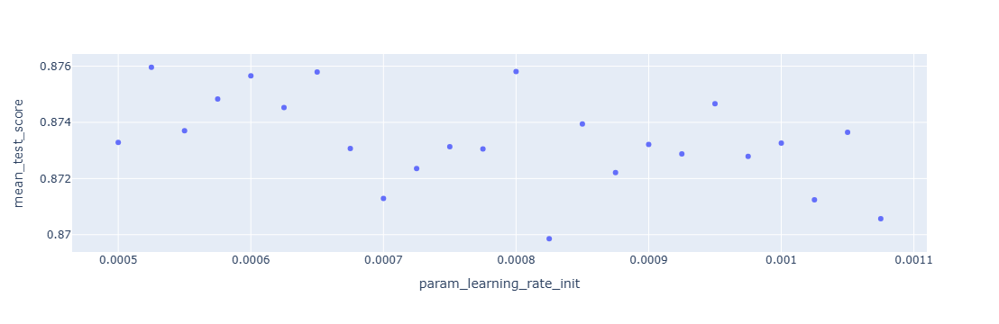

In [35]:
px.scatter(grid_mlp_lri,
           x='param_learning_rate_init',
           y='mean_test_score',
           width=600
          )

**(0.0005, 0.000525, ... , 0.000975, 0.001)**

# **MLP** - Batch Size (unused)

In [93]:
param_grid = {
    'batch_size': [32, 64, 128, 256]
}

grid_search = GridSearchCV(estimator=MLPClassifier(random_state=42),
                        param_grid=param_grid,
                        refit=True,
                        scoring='f1',
                        cv=10, verbose=3)

grid_search.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 4 candidates, totalling 40 fits
[CV 1/10] END ....................batch_size=32;, score=0.895 total time=   8.5s
[CV 2/10] END ....................batch_size=32;, score=0.864 total time=   8.7s
[CV 3/10] END ....................batch_size=32;, score=0.863 total time=   8.5s
[CV 4/10] END ....................batch_size=32;, score=0.887 total time=   8.4s
[CV 5/10] END ....................batch_size=32;, score=0.838 total time=   8.2s
[CV 6/10] END ....................batch_size=32;, score=0.885 total time=   8.4s
[CV 7/10] END ....................batch_size=32;, score=0.854 total time=   8.5s
[CV 8/10] END ....................batch_size=32;, score=0.873 total time=   8.6s
[CV 9/10] END ....................batch_size=32;, score=0.872 total time=   8.5s
[CV 10/10] END ...................batch_size=32;, score=0.871 total time=   8.2s
[CV 1/10] END ....................batch_size=64;, score=0.909 total time=   5.0s
[CV 2/10] END ....................batch_size=64;

GridSearchCV(cv=10, estimator=MLPClassifier(random_state=42),
             param_grid={'batch_size': [32, 64, 128, 256]}, scoring='f1',
             verbose=3)

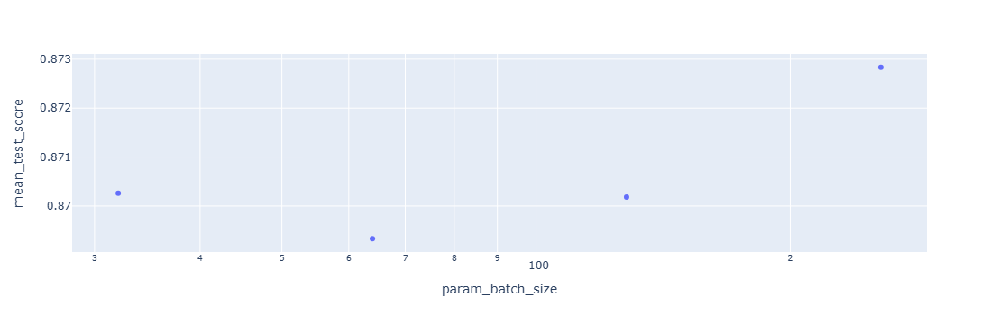

In [94]:
grid_results_mlp_3 = pd.DataFrame(grid_search.cv_results_)

px.scatter(grid_results_mlp_3, x='param_batch_size', y='mean_test_score', log_x=True)

In [95]:
param_grid = {
    'batch_size': [200]
}

grid_search = GridSearchCV(estimator=MLPClassifier(random_state=42),
                        param_grid=param_grid,
                        refit=True,
                        scoring='f1',
                        cv=10, verbose=3)

grid_search.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 1 candidates, totalling 10 fits
[CV 1/10] END ...................batch_size=200;, score=0.898 total time=   3.6s
[CV 2/10] END ...................batch_size=200;, score=0.857 total time=   3.7s
[CV 3/10] END ...................batch_size=200;, score=0.875 total time=   3.7s
[CV 4/10] END ...................batch_size=200;, score=0.904 total time=   4.1s
[CV 5/10] END ...................batch_size=200;, score=0.839 total time=   3.8s
[CV 6/10] END ...................batch_size=200;, score=0.863 total time=   3.7s
[CV 7/10] END ...................batch_size=200;, score=0.862 total time=   3.7s
[CV 8/10] END ...................batch_size=200;, score=0.871 total time=   3.5s
[CV 9/10] END ...................batch_size=200;, score=0.891 total time=   3.5s
[CV 10/10] END ..................batch_size=200;, score=0.872 total time=   3.5s


GridSearchCV(cv=10, estimator=MLPClassifier(random_state=42),
             param_grid={'batch_size': [200]}, scoring='f1', verbose=3)

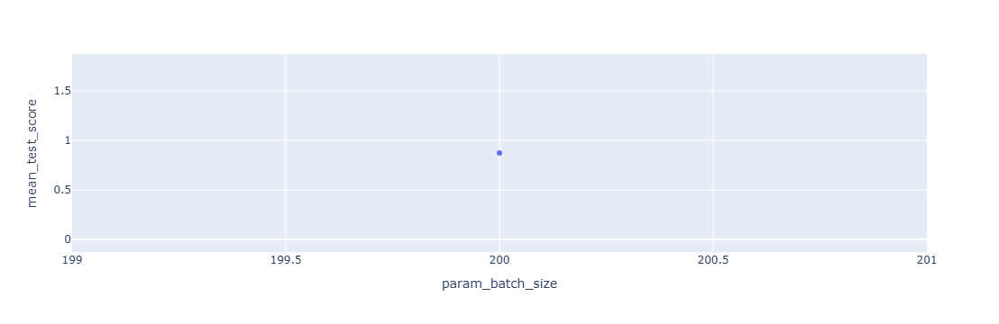

In [96]:
grid_results_mlp_3 = pd.DataFrame(grid_search.cv_results_)

px.scatter(grid_results_mlp_3, x='param_batch_size', y='mean_test_score')

In [97]:
param_grid = {
    'batch_size': [180, 190, 200, 210, 220, 230, 240, 250, 260, 270, 280]
}

grid_search = GridSearchCV(estimator=MLPClassifier(random_state=42),
                        param_grid=param_grid,
                        refit=True,
                        scoring='f1',
                        cv=10, verbose=3)

grid_search.fit(X_train_scaled, y_train)

Fitting 10 folds for each of 11 candidates, totalling 110 fits
[CV 1/10] END ...................batch_size=180;, score=0.898 total time=   3.9s
[CV 2/10] END ...................batch_size=180;, score=0.853 total time=   4.2s
[CV 3/10] END ...................batch_size=180;, score=0.873 total time=   4.0s
[CV 4/10] END ...................batch_size=180;, score=0.896 total time=   3.7s
[CV 5/10] END ...................batch_size=180;, score=0.837 total time=   4.0s
[CV 6/10] END ...................batch_size=180;, score=0.869 total time=   4.2s
[CV 7/10] END ...................batch_size=180;, score=0.855 total time=   4.2s
[CV 8/10] END ...................batch_size=180;, score=0.875 total time=   4.3s
[CV 9/10] END ...................batch_size=180;, score=0.885 total time=   4.1s
[CV 10/10] END ..................batch_size=180;, score=0.882 total time=   4.2s
[CV 1/10] END ...................batch_size=190;, score=0.897 total time=   4.1s
[CV 2/10] END ...................batch_size=19

GridSearchCV(cv=10, estimator=MLPClassifier(random_state=42),
             param_grid={'batch_size': [180, 190, 200, 210, 220, 230, 240, 250,
                                        260, 270, 280]},
             scoring='f1', verbose=3)

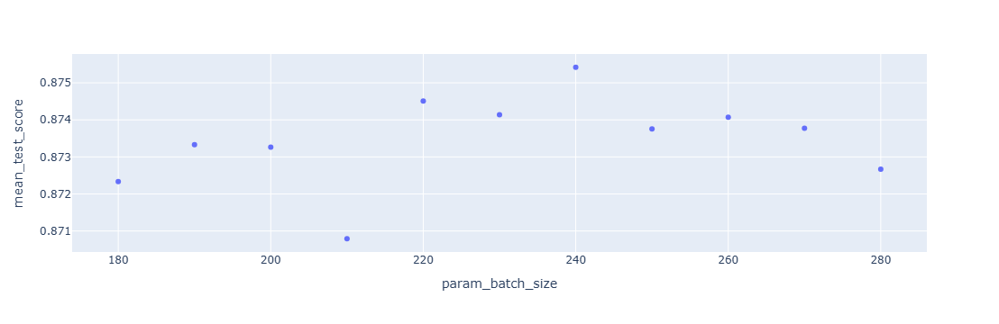

In [98]:
grid_results_mlp_3 = pd.DataFrame(grid_search.cv_results_)

px.scatter(grid_results_mlp_3, x='param_batch_size', y='mean_test_score')

# **MLP** - Hidden Layer Sizes

In [27]:
grid_mlp_hls, best_mlp_hls_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'hidden_layer_sizes': np.arange(10, 201, 10)},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[CV 1/10] END ............hidden_layer_sizes=10;, score=0.879 total time=   1.2s
[CV 2/10] END ............hidden_layer_sizes=10;, score=0.857 total time=   1.2s
[CV 3/10] END ............hidden_layer_sizes=10;, score=0.867 total time=   1.1s
[CV 4/10] END ............hidden_layer_sizes=10;, score=0.883 total time=   1.2s
[CV 5/10] END ............hidden_layer_sizes=10;, score=0.824 total time=   1.2s
[CV 6/10] END ............hidden_layer_sizes=10;, score=0.865 total time=   1.2s
[CV 7/10] END ............hidden_layer_sizes=10;, score=0.841 total time=   1.1s
[CV 8/10] END ............hidden_layer_sizes=10;, score=0.866 total time=   1.2s
[CV 9/10] END ............hidden_layer_sizes=10;, score=0.891 total time=   1.3s
[CV 10/10] END ...........hidden_layer_sizes=10;, score=0.881 total time=   1.2s
[CV 1/10] END ............hidden_layer_sizes=20;, score=0.896 total time=   1.3s
[CV 2/10] END ............hidden_layer_sizes=2

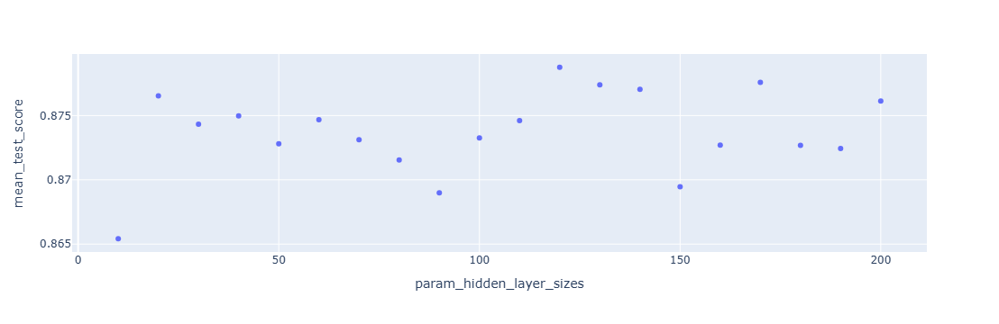

In [30]:
px.scatter(grid_mlp_hls,
           x='param_hidden_layer_sizes',
           y='mean_test_score',
           width=600
          )

In [37]:
grid_mlp_hls, best_mlp_hls_model = run_grid(MLPClassifier(random_state=42),
                                            param_grid={'hidden_layer_sizes': [(10*i, 10*i) for i in range(1, 21)]},
                                            X=X_train_scaled,
                                            y=y_train)

Fitting 10 folds for each of 20 candidates, totalling 200 fits
[CV 1/10] END ......hidden_layer_sizes=(10, 10);, score=0.893 total time=   1.6s
[CV 2/10] END ......hidden_layer_sizes=(10, 10);, score=0.871 total time=   1.6s
[CV 3/10] END ......hidden_layer_sizes=(10, 10);, score=0.877 total time=   1.6s
[CV 4/10] END ......hidden_layer_sizes=(10, 10);, score=0.900 total time=   1.6s
[CV 5/10] END ......hidden_layer_sizes=(10, 10);, score=0.841 total time=   1.6s
[CV 6/10] END ......hidden_layer_sizes=(10, 10);, score=0.888 total time=   1.6s
[CV 7/10] END ......hidden_layer_sizes=(10, 10);, score=0.853 total time=   1.7s
[CV 8/10] END ......hidden_layer_sizes=(10, 10);, score=0.876 total time=   1.7s
[CV 9/10] END ......hidden_layer_sizes=(10, 10);, score=0.887 total time=   1.7s
[CV 10/10] END .....hidden_layer_sizes=(10, 10);, score=0.866 total time=   1.7s
[CV 1/10] END ......hidden_layer_sizes=(20, 20);, score=0.895 total time=   2.1s
[CV 2/10] END ......hidden_layer_sizes=(20, 20

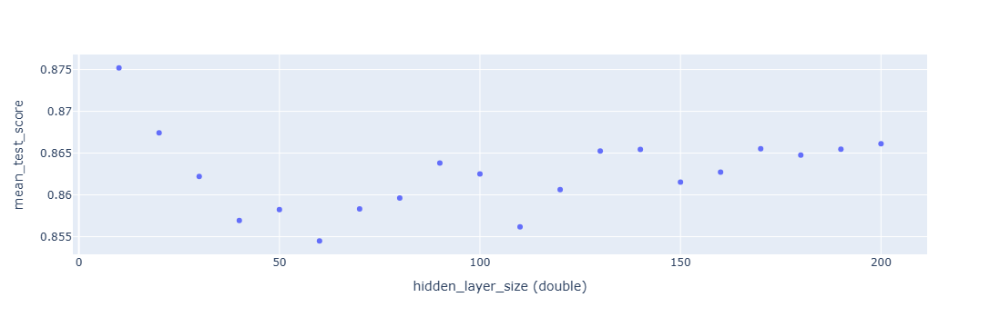

In [62]:
grid_mlp_hls['hidden_layer_size (double)'] = [10*i for i in range(1, 21)]
grid_mlp_hls

px.scatter(grid_mlp_hls,
           x='hidden_layer_size (double)',
           y='mean_test_score',
           width=600
          )

# **MLP** - Hidden Layer Sizes (2)

In [50]:
param_grid = {
    'hidden_layer_sizes': [
    (10,), (30,), (50,), (100,),
    (10, 10), (30, 30), (50, 50), (100, 100),
    (10, 10, 10), (30, 30, 30), (50, 50, 50),
    (100, 50), (50, 30, 10)
]
}

grid_search = GridSearchCV(estimator=MLPClassifier(random_state=42),
                        param_grid=param_grid,
                        refit=True,
                        scoring='f1',
                        cv=10, verbose=3)

grid_search.fit(X_train_scaled, y_train)



Fitting 10 folds for each of 13 candidates, totalling 130 fits
[CV 1/10] END .........hidden_layer_sizes=(10,);, score=0.879 total time=   1.2s
[CV 2/10] END .........hidden_layer_sizes=(10,);, score=0.857 total time=   1.2s
[CV 3/10] END .........hidden_layer_sizes=(10,);, score=0.867 total time=   1.2s
[CV 4/10] END .........hidden_layer_sizes=(10,);, score=0.883 total time=   1.1s
[CV 5/10] END .........hidden_layer_sizes=(10,);, score=0.824 total time=   1.1s
[CV 6/10] END .........hidden_layer_sizes=(10,);, score=0.865 total time=   1.1s
[CV 7/10] END .........hidden_layer_sizes=(10,);, score=0.841 total time=   1.1s
[CV 8/10] END .........hidden_layer_sizes=(10,);, score=0.866 total time=   1.2s
[CV 9/10] END .........hidden_layer_sizes=(10,);, score=0.891 total time=   1.2s
[CV 10/10] END ........hidden_layer_sizes=(10,);, score=0.881 total time=   1.2s
[CV 1/10] END .........hidden_layer_sizes=(30,);, score=0.899 total time=   1.5s
[CV 2/10] END .........hidden_layer_sizes=(30,

GridSearchCV(cv=10, estimator=MLPClassifier(random_state=42),
             param_grid={'hidden_layer_sizes': [(10,), (30,), (50,), (100,),
                                                (10, 10), (30, 30), (50, 50),
                                                (100, 100), (10, 10, 10),
                                                (30, 30, 30), (50, 50, 50),
                                                (100, 50), (50, 30, 10)]},
             scoring='f1', verbose=3)

In [59]:
grid_results_mlp_3 = pd.DataFrame(grid_search.cv_results_)
grid_results_mlp_3 = grid_results_mlp_3[['param_hidden_layer_sizes', 'mean_test_score', 'std_test_score']]
grid_results_mlp_3.sort_values("mean_test_score")

# px.scatter(grid_results_mlp_3, x="mean_test_score", y="std_test_score", color="param_hidden_layer_sizes", height=600)

,param_hidden_layer_sizes,mean_test_score,std_test_score
10,"(50, 50, 50)",0.841358,0.017107
9,"(30, 30, 30)",0.844248,0.009492
12,"(50, 30, 10)",0.844433,0.017071
11,"(100, 50)",0.856412,0.019014
6,"(50, 50)",0.858241,0.017806
5,"(30, 30)",0.862205,0.017116
7,"(100, 100)",0.862501,0.014096
0,"(10,)",0.865417,0.019404
2,"(50,)",0.872808,0.019477
3,"(100,)",0.873266,0.018858


In [63]:
param_grid = {
    'hidden_layer_sizes': [(8, 8, 8),
                           (9, 9, 9), 
                           (10, 10, 10),
                           (11, 11, 11),
                           (12, 12, 12),
                           (10, 10, 10, 10),
                           (8, 10, 8),
                           (12, 10, 12),
                           (10, 12, 10),
                           (10, 8, 10),
                           (8, 10, 12),
                           (12, 10, 8),
                           (8, 8),
                           (9, 9),
                           (10, 10),
                           (11, 11),
                           (12, 12),
                           (8, 10),
                           (10, 8),
                           (12, 10),
                           (10, 12),
                           (15, 10),
                           (10, 15),
                           (20, 10),
                           (10, 20),
                          ]
}

grid_search = GridSearchCV(estimator=MLPClassifier(random_state=42),
                        param_grid=param_grid,
                        refit=True,
                        scoring='f1',
                        cv=10, verbose=3)

grid_search.fit(X_train_scaled, y_train)



Fitting 10 folds for each of 25 candidates, totalling 250 fits
[CV 1/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.886 total time=   1.9s
[CV 2/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.860 total time=   1.8s
[CV 3/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.875 total time=   1.9s
[CV 4/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.891 total time=   1.9s
[CV 5/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.840 total time=   1.9s
[CV 6/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.895 total time=   1.8s
[CV 7/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.855 total time=   1.8s
[CV 8/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.879 total time=   1.9s
[CV 9/10] END .....hidden_layer_sizes=(8, 8, 8);, score=0.899 total time=   1.8s
[CV 10/10] END ....hidden_layer_sizes=(8, 8, 8);, score=0.879 total time=   1.9s
[CV 1/10] END .....hidden_layer_sizes=(9, 9, 9);, score=0.893 total time=   2.0s
[CV 2/10] END .....hidden_layer_sizes=(9, 9, 9

GridSearchCV(cv=10, estimator=MLPClassifier(random_state=42),
             param_grid={'hidden_layer_sizes': [(8, 8, 8), (9, 9, 9),
                                                (10, 10, 10), (11, 11, 11),
                                                (12, 12, 12), (10, 10, 10, 10),
                                                (8, 10, 8), (12, 10, 12),
                                                (10, 12, 10), (10, 8, 10),
                                                (8, 10, 12), (12, 10, 8),
                                                (8, 8), (9, 9), (10, 10),
                                                (11, 11), (12, 12), (8, 10),
                                                (10, 8), (12, 10), (10, 12),
                                                (15, 10), (10, 15), (20, 10),
                                                (10, 20)]},
             scoring='f1', verbose=3)

In [64]:
grid_results_mlp_3 = pd.DataFrame(grid_search.cv_results_)
grid_results_mlp_3 = grid_results_mlp_3[['param_hidden_layer_sizes', 'mean_test_score', 'std_test_score']]
grid_results_mlp_3.sort_values("mean_test_score", ascending=False)

,param_hidden_layer_sizes,mean_test_score,std_test_score
18,"(10, 8)",0.882577,0.017931
16,"(12, 12)",0.879290,0.019628
8,"(10, 12, 10)",0.878852,0.018922
19,"(12, 10)",0.878588,0.018493
24,"(10, 20)",0.878449,0.019539
2,"(10, 10, 10)",0.878273,0.019180
1,"(9, 9, 9)",0.877243,0.014448
6,"(8, 10, 8)",0.876745,0.019337
17,"(8, 10)",0.876670,0.018444
0,"(8, 8, 8)",0.875810,0.018020


# **MLP** - Activation

In [39]:
grid_mlp_acti, best_mlp_acti_model = run_grid(MLPClassifier(random_state=42),
                                              param_grid={'activation': ['identity', 'logistic', 'tanh', 'relu']},
                                              X=X_train_scaled,
                                              y=y_train)

Fitting 10 folds for each of 4 candidates, totalling 40 fits
[CV 1/10] END ..............activation=identity;, score=0.853 total time=   0.3s
[CV 2/10] END ..............activation=identity;, score=0.831 total time=   0.2s
[CV 3/10] END ..............activation=identity;, score=0.837 total time=   0.4s
[CV 4/10] END ..............activation=identity;, score=0.833 total time=   0.1s
[CV 5/10] END ..............activation=identity;, score=0.814 total time=   0.2s
[CV 6/10] END ..............activation=identity;, score=0.793 total time=   0.1s
[CV 7/10] END ..............activation=identity;, score=0.789 total time=   0.1s
[CV 8/10] END ..............activation=identity;, score=0.821 total time=   0.1s
[CV 9/10] END ..............activation=identity;, score=0.826 total time=   0.1s
[CV 10/10] END .............activation=identity;, score=0.814 total time=   0.1s
[CV 1/10] END ..............activation=logistic;, score=0.896 total time=   8.5s
[CV 2/10] END ..............activation=logistic;

In [46]:
grid_mlp_acti[['param_activation', 'mean_test_score', 'std_test_score']].sort_values('mean_test_score', ascending=False)

,param_activation,mean_test_score,std_test_score
1,logistic,0.883065,0.017081
3,relu,0.873266,0.018858
2,tanh,0.864736,0.013732
0,identity,0.821060,0.018478


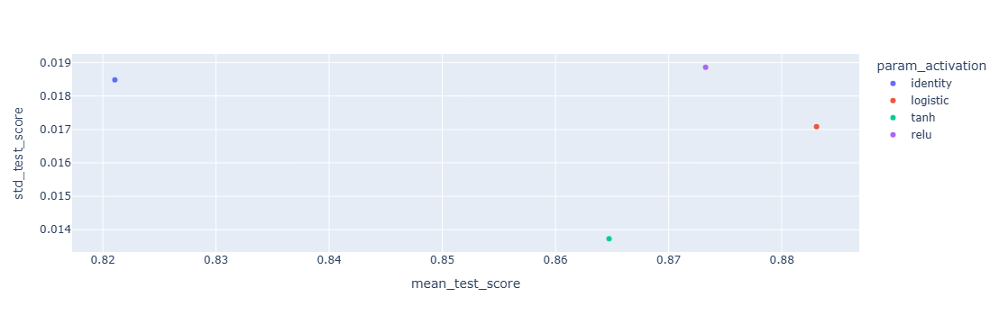

In [41]:
px.scatter(grid_mlp_acti,
           x='mean_test_score',
           y='std_test_score',
           color='param_activation',
           width=600
          )

# **MLP** - *

In [12]:
grid_mlp_acti, best_mlp_acti_model = run_grid(MLPClassifier(random_state=42),
                                              param_grid={
                                                  'activation': ['identity', 'logistic', 'tanh', 'relu'],
                                                  'learning_rate_init': [0.0006, 0.0008, 0.001],
                                                  'hidden_layer_sizes': [(10, 8), (12, 12), (10, 12, 10), (12, 10), (10, 20), (10, 10, 10), (100,)],
                                                  'alpha': [0.0001, 0.185, 0.1975, 0.2375, 0.2825, 0.3075, 0.3325]
                                              },
                                              X=X_train_scaled,
                                              y=y_train)

Fitting 10 folds for each of 588 candidates, totalling 5880 fits
[CV 1/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.856 total time=   0.2s
[CV 2/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.837 total time=   0.2s
[CV 3/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.838 total time=   0.2s
[CV 4/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.834 total time=   0.1s
[CV 5/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.813 total time=   0.2s
[CV 6/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.797 total time=   0.2s
[CV 7/10] END activation=identity, alpha=0.0001, hidden_layer_sizes=(10, 8), learning_rate_init=0.0006;, score=0.792 to

In [13]:
grid_mlp_acti.to_csv('mlp_optimal.csv')

In [45]:
grid_mlp_acti[
['rank_test_score', 'param_activation', 'param_alpha', 'param_hidden_layer_sizes', 'param_learning_rate_init', 'mean_test_score', 'std_test_score']
].sort_values('rank_test_score').head(60)
# grid_mlp_acti['param_activation'] == 'identity']

,rank_test_score,param_activation,param_alpha,param_hidden_layer_sizes,param_learning_rate_init,mean_test_score,std_test_score
397,1,tanh,0.2825,"(100,)",0.0008,0.886089,0.016880
587,2,relu,0.3325,"(100,)",0.0010,0.885369,0.016230
524,3,relu,0.2375,"(100,)",0.0010,0.885367,0.018403
482,4,relu,0.1850,"(100,)",0.0010,0.885327,0.014411
503,5,relu,0.1975,"(100,)",0.0010,0.885319,0.017126
545,6,relu,0.2825,"(100,)",0.0010,0.885262,0.017081
566,7,relu,0.3075,"(100,)",0.0010,0.885197,0.016921
417,8,tanh,0.3075,"(100,)",0.0006,0.885113,0.018341
419,9,tanh,0.3075,"(100,)",0.0010,0.885088,0.017042
376,10,tanh,0.2375,"(100,)",0.0008,0.885000,0.016176


In [19]:
evaluate_model(best_mlp_acti_model, X_train_scaled, y_train, X_test_scaled, y_test)

MLPClassifier with non-default parameters set {'activation': 'tanh', 'alpha': 0.2825, 'learning_rate_init': 0.0008, 'random_state': 42}:
Train F1: 0.90578
Test F1: 0.90173



In [46]:
grid_mlp, best_mlp_model = run_grid(MLPClassifier(random_state=42),
                                    param_grid={
                                        'activation': ['tanh', 'relu'],
                                        'learning_rate_init': [0.001],
                                        'hidden_layer_sizes': [(80,), (90,), (100,), (110,), (120,), (60, 60), (80, 80), (100, 100), (120, 120)],
                                        'alpha': [0.185, 0.2375, 0.2825, 0.3325]
                                    },
                                    X=X_train_scaled,
                                    y=y_train)

Fitting 10 folds for each of 72 candidates, totalling 720 fits
[CV 1/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.898 total time=   3.4s
[CV 2/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.858 total time=   3.2s
[CV 3/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.888 total time=   3.1s
[CV 4/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.891 total time=   3.1s
[CV 5/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.832 total time=   3.1s
[CV 6/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.888 total time=   3.0s
[CV 7/10] END activation=tanh, alpha=0.185, hidden_layer_sizes=(80,), learning_rate_init=0.001;, score=0.847 total time=   3.0s
[CV 8/10] END activation=tanh, alpha=0.18

In [47]:
grid_mlp.to_csv('mlp_optimal2.csv')

In [53]:
grid_mlp[
['rank_test_score', 'param_activation', 'param_alpha', 'param_hidden_layer_sizes', 'param_learning_rate_init', 'mean_test_score', 'std_test_score']
].sort_values('rank_test_score').head(60)
# grid_mlp_acti['param_activation'] == 'identity']

,rank_test_score,param_activation,param_alpha,param_hidden_layer_sizes,param_learning_rate_init,mean_test_score,std_test_score
49,1,relu,0.2375,"(120,)",0.001,0.886914,0.017033
67,2,relu,0.3325,"(120,)",0.001,0.885561,0.019006
65,3,relu,0.3325,"(100,)",0.001,0.885369,0.016230
47,4,relu,0.2375,"(100,)",0.001,0.885367,0.018403
38,5,relu,0.1850,"(100,)",0.001,0.885327,0.014411
56,6,relu,0.2825,"(100,)",0.001,0.885262,0.017081
57,7,relu,0.2825,"(110,)",0.001,0.885219,0.015077
40,8,relu,0.1850,"(120,)",0.001,0.885171,0.018471
58,9,relu,0.2825,"(120,)",0.001,0.884995,0.019219
48,10,relu,0.2375,"(110,)",0.001,0.884702,0.014886


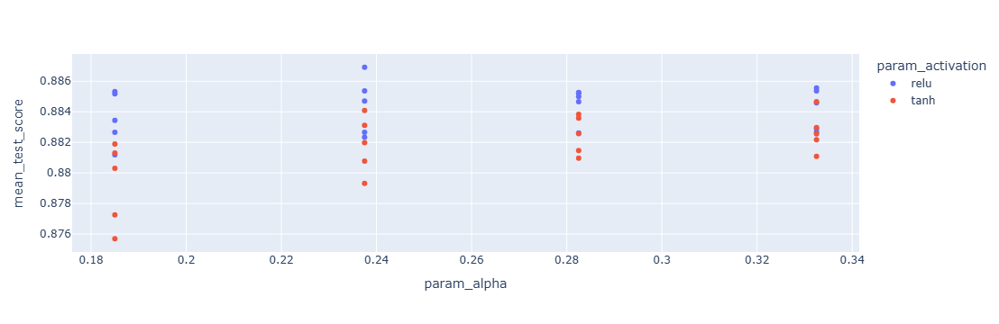

In [86]:
grid2 = grid_mlp.sort_values('rank_test_score').head(40)
grid2['hls'] = grid2['param_hidden_layer_sizes'].str[0]
grid2

px.scatter(grid2,
           x='param_alpha',
           y='mean_test_score',
           color='param_activation',
           # size='mean_test_score',
           width=600
          )

In [90]:
grid_mlp2, best_mlp2_model = run_grid(MLPClassifier(random_state=42),
                                      param_grid={
                                          'activation': ['relu'],
                                          'learning_rate_init': [0.001],
                                          'hidden_layer_sizes': [(100,), (110,), (120,), (130,), (140,), (150,), (8, 8), (10, 10), (12, 12), (14, 14)],
                                          'alpha': [0.185, 0.2375, 0.2825, 0.3325, 0.39, 0.45]
                                      },
                                      X=X_train_scaled,
                                      y=y_train)

Fitting 10 folds for each of 60 candidates, totalling 600 fits
[CV 1/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.906 total time=   3.7s
[CV 2/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.887 total time=   3.6s
[CV 3/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.882 total time=   3.6s
[CV 4/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.903 total time=   3.6s
[CV 5/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.859 total time=   3.6s
[CV 6/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.884 total time=   3.6s
[CV 7/10] END activation=relu, alpha=0.185, hidden_layer_sizes=(100,), learning_rate_init=0.001;, score=0.864 total time=   3.6s
[CV 8/10] END activation=relu, alp

In [91]:
grid_mlp2.to_csv('mlp_optimal3.csv')

In [95]:
grid3 = grid_mlp2.sort_values('rank_test_score').head(40)
grid3[['rank_test_score', 'param_activation', 'param_alpha', 'param_hidden_layer_sizes', 'param_learning_rate_init', 'mean_test_score', 'std_test_score']]

,rank_test_score,param_activation,param_alpha,param_hidden_layer_sizes,param_learning_rate_init,mean_test_score,std_test_score
12,1,relu,0.2375,"(120,)",0.001,0.886914,0.017033
4,2,relu,0.1850,"(140,)",0.001,0.886828,0.016944
15,3,relu,0.2375,"(150,)",0.001,0.886608,0.018503
42,4,relu,0.3900,"(120,)",0.001,0.886299,0.018829
23,5,relu,0.2825,"(130,)",0.001,0.885936,0.018274
32,6,relu,0.3325,"(120,)",0.001,0.885561,0.019006
24,7,relu,0.2825,"(140,)",0.001,0.885415,0.016450
30,8,relu,0.3325,"(100,)",0.001,0.885369,0.016230
10,9,relu,0.2375,"(100,)",0.001,0.885367,0.018403
0,10,relu,0.1850,"(100,)",0.001,0.885327,0.014411


In [96]:
evaluate_model(best_mlp2_model, X_train_scaled, y_train, X_test_scaled, y_test)

MLPClassifier with non-default parameters set {'alpha': 0.2375, 'hidden_layer_sizes': (120,), 'random_state': 42}:
Train F1: 0.92699
Test F1: 0.89815



In [31]:
model = MLPClassifier(alpha=0.2375, hidden_layer_sizes=(120,), random_state=42)
model.fit(X_train_scaled, y_train)
evaluate_model(model, X_train_scaled, y_train, X_test_scaled, y_test)

MLPClassifier with non-default parameters set {'alpha': 0.2375, 'hidden_layer_sizes': (120,), 'random_state': 42}:
Train F1: 0.92699
Test F1: 0.89815



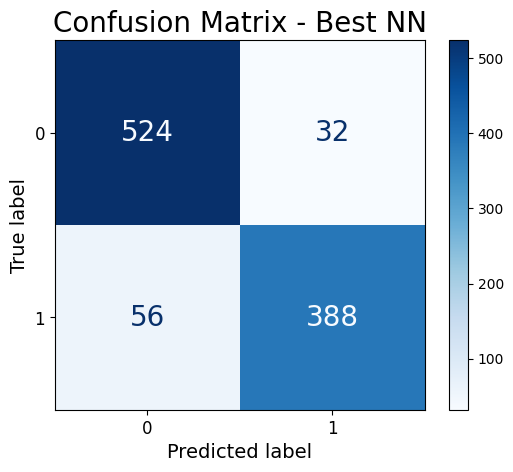

In [50]:
# Assuming y_test and model.predict(X_test_scaled) are already defined
cm = confusion_matrix(y_test, model.predict(X_test_scaled))
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
ax = disp.plot(cmap=plt.cm.Blues)

# Set the font size of the labels
ax.ax_.set_xlabel('Predicted label', fontsize=14)
ax.ax_.set_ylabel('True label', fontsize=14)
ax.ax_.set_title('Confusion Matrix - Best NN', fontsize=20)

# Set the font size of the tick labels
ax.ax_.tick_params(axis='both', which='major', labelsize=12)

# Adjust the font size of the text inside the plot
for text in ax.ax_.texts:
    text.set_fontsize(20)

plt.show()

# **XGB** - *

In [ ]:
xgb_basic = XGBClassifier(random_state=42)
xgb_basic.fit(X_train, y_train)
evaluate_model(xgb_basic, X_train, y_train, X_test, y_test)

In [29]:
grid_xgb, best_xgb = run_grid(XGBClassifier(random_state=42),
                              param_grid={
                                  'max_depth': [3, 4, 5, 6],
                                  'learning_rate': [0.01, 0.1, 0.2],
                                  'n_estimators': [100, 200, 300],
                                  'subsample': [0.8, 0.9, 1.0],
                                  'colsample_bytree': [0.8, 0.9, 1.0],
                                  'gamma': [0, 0.1, 0.2],
                                  'min_child_weight': [1, 3, 5]
                              },
                              X=X_train,
                              y=y_train
                             )

Fitting 10 folds for each of 2916 candidates, totalling 29160 fits
[CV 1/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, subsample=0.8;, score=0.870 total time=   0.0s
[CV 2/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, subsample=0.8;, score=0.865 total time=   0.0s
[CV 3/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, subsample=0.8;, score=0.841 total time=   0.0s
[CV 4/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, subsample=0.8;, score=0.860 total time=   0.0s
[CV 5/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, subsample=0.8;, score=0.827 total time=   0.0s
[CV 6/10] END colsample_bytree=0.8, gamma=0, learning_rate=0.01, max_depth=3, min_child_weight=1, n_estimators=100, su

In [31]:
grid_xgb[['rank_test_score','param_colsample_bytree','param_gamma','param_learning_rate','param_max_depth',
         'param_min_child_weight','param_n_estimators','mean_test_score','std_test_score']].sort_values('rank_test_score').head(50)

,rank_test_score,param_colsample_bytree,param_gamma,param_learning_rate,param_max_depth,param_min_child_weight,param_n_estimators,mean_test_score,std_test_score
171,1,0.8,0.0,0.1,5,3,100,0.897920,0.016599
1435,2,0.9,0.1,0.1,4,1,200,0.897852,0.014381
168,3,0.8,0.0,0.1,5,1,300,0.897501,0.013704
1577,4,0.9,0.1,0.2,5,3,100,0.897487,0.013305
1785,5,0.9,0.2,0.1,5,1,200,0.897480,0.014954
2245,6,1.0,0.0,0.2,6,1,200,0.897467,0.015673
199,7,0.8,0.0,0.1,6,3,100,0.897440,0.016620
1129,8,0.9,0.0,0.1,4,5,200,0.897439,0.014148
2457,9,1.0,0.1,0.1,6,1,100,0.897389,0.015137
814,10,0.8,0.2,0.1,5,1,200,0.897345,0.015314


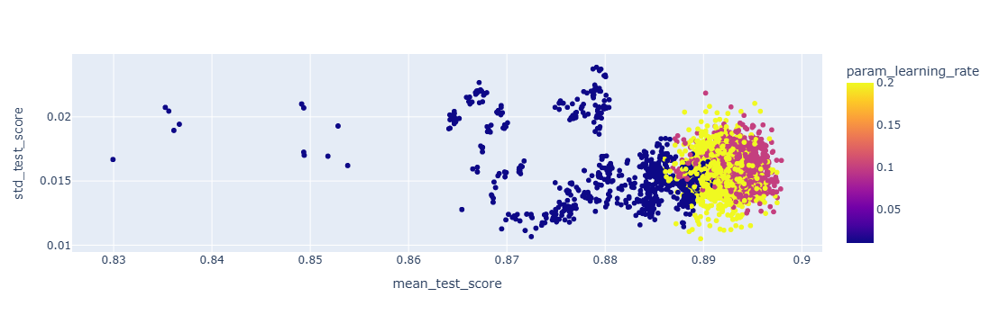

In [34]:
px.scatter(grid_xgb, x='mean_test_score', y='std_test_score', color='param_learning_rate', width=600)

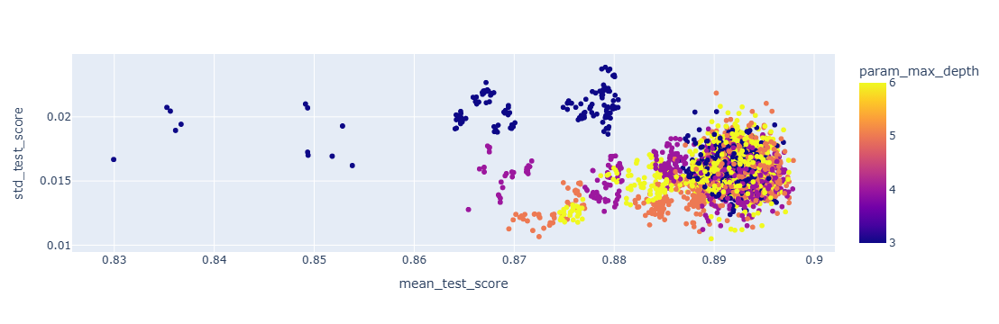

In [35]:
px.scatter(grid_xgb, x='mean_test_score', y='std_test_score', color='param_max_depth', width=600)

In [38]:
evaluate_model(best_xgb, X_train, y_train, X_test, y_test)

XGBClassifier with non-default parameters set {'colsample_bytree': 0.8, 'gamma': 0, 'learning_rate': 0.1, 'max_depth': 5, 'min_child_weight': 3, 'missing': nan, 'n_estimators': 100, 'random_state': 42, 'subsample': 0.8}:
Train F1: 0.92833
Test F1: 0.91455



In [59]:
xgb_best = XGBClassifier(colsample_bytree=0.8, gamma=0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimator=100, random_state=42, subsample=0.8)
xgb_best.fit(X_train, y_train)

train_preds = xgb_best.predict(X_train)
test_preds = xgb_best.predict(X_test)

print('Train F1: ', f1_score(y_train, train_preds))
print('Test F1: ', f1_score(y_test, test_preds))

Train F1:  0.928331630418917
Test F1:  0.9145496535796767


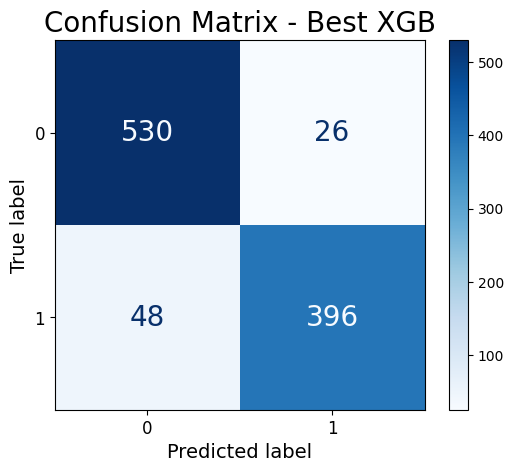

In [60]:
cm = confusion_matrix(y_test, xgb_best.predict(X_test))
disp = ConfusionMatrixDisplay(confusion_matrix=cm)
ax = disp.plot(cmap=plt.cm.Blues)

ax.ax_.set_xlabel('Predicted label', fontsize=14)
ax.ax_.set_ylabel('True label', fontsize=14)
ax.ax_.set_title('Confusion Matrix - Best XGB', fontsize=20)

ax.ax_.tick_params(axis='both', which='major', labelsize=12)

for text in ax.ax_.texts:
    text.set_fontsize(20)

plt.show()

# **XGB** - Failed attempts to improve

In [40]:
xgb = XGBClassifier(random_state=42)

param_grid = {
    'max_depth': [4, 5],
    'learning_rate': [0.05, 0.1, 0.15],
    'n_estimators': [100, 150, 200],
    'subsample': [0.8, 0.9],
    'colsample_bytree': [0.8, 0.9],
    'gamma': [0.0, 0.1],
    'min_child_weight': [1, 3],
    'alpha': [0, 0.1, 1],
    'lambda': [0, 0.1, 1]
}

grid_search2 = RandomizedSearchCV(estimator=xgb, param_distributions=param_grid,
                           n_iter=500,cv=10, scoring='f1', verbose=2, random_state=42)
grid_search2.fit(X_train, y_train)

print("Best parameters:", grid_search2.best_params_)
print("Best cross-validation score:", grid_search2.best_score_)

best_model2 = grid_search2.best_estimator_
y_pred = best_model2.predict(X_test)

# הערכת ביצועי המודל
print("F1 on test set:", f1_score(y_test, y_pred))
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Fitting 10 folds for each of 500 candidates, totalling 5000 fits
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=150, subsample=0.9; total time=   0.0s
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=150, subsample=0.9; total time=   0.0s
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=150, subsample=0.9; total time=   0.0s
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=150, subsample=0.9; total time=   0.0s
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_weight=3, n_estimators=150, subsample=0.9; total time=   0.0s
[CV] END alpha=1, colsample_bytree=0.9, gamma=0.0, lambda=1, learning_rate=0.05, max_depth=4, min_child_w

In [42]:
results = pd.DataFrame(grid_search2.cv_results_)
results[['rank_test_score','param_colsample_bytree','param_gamma','param_learning_rate','param_max_depth',
         'param_min_child_weight','param_n_estimators','param_alpha','param_lambda',
          'mean_test_score','std_test_score']].sort_values('rank_test_score').head(50)

,rank_test_score,param_colsample_bytree,param_gamma,param_learning_rate,param_max_depth,param_min_child_weight,param_n_estimators,param_alpha,param_lambda,mean_test_score,std_test_score
124,1,0.8,0.1,0.10,4,3,150,1.0,1.0,0.898085,0.016305
263,2,0.9,0.1,0.10,4,1,200,0.0,1.0,0.897852,0.014381
320,3,0.8,0.1,0.10,5,1,150,1.0,0.0,0.897565,0.014055
38,4,0.9,0.1,0.10,5,1,100,0.0,0.1,0.897504,0.014336
338,5,0.9,0.0,0.10,5,3,100,0.1,0.0,0.897385,0.017606
76,6,0.9,0.1,0.10,4,1,150,0.0,1.0,0.897378,0.015005
404,7,0.8,0.1,0.10,5,3,150,0.0,0.1,0.897342,0.016074
250,8,0.8,0.1,0.10,5,3,150,0.1,0.1,0.897288,0.015043
184,9,0.9,0.1,0.10,4,3,200,1.0,1.0,0.897234,0.015942
288,10,0.8,0.1,0.10,5,1,100,0.0,0.1,0.897092,0.016124


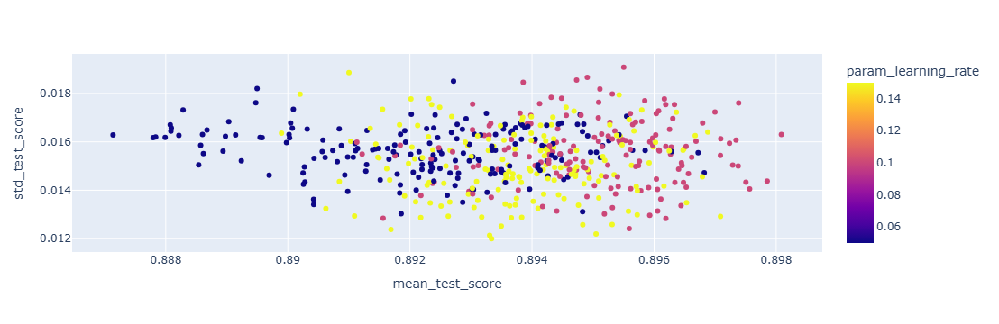

In [45]:
px.scatter(results, x='mean_test_score', y='std_test_score', color='param_learning_rate', width=600)

In [48]:
xgb = XGBClassifier(random_state=42)

param_grid = {
    'max_depth': [4, 5],
    'learning_rate': [0.1],
    'n_estimators': [100, 150, 200],
    'subsample': [0.8, 0.9],
    'colsample_bytree': [0.8, 0.9],
    'gamma': [0.1],
    'min_child_weight': [1, 3],
    'alpha': [0, 0.1, 1],
    'lambda': [0, 0.1, 1],
    'scale_pos_weight': [0.5, 1, 1.5, 2],
}

grid_search3 = RandomizedSearchCV(estimator=xgb, param_distributions=param_grid,
                           n_iter=500,cv=10, scoring='f1', verbose=2, random_state=42)
grid_search3.fit(X_train, y_train)

print("Best parameters:", grid_search3.best_params_)
print("Best cross-validation score:", grid_search3.best_score_)

best_model3 = grid_search3.best_estimator_
y_pred = best_model3.predict(X_test)

# הערכת ביצועי המודל
print("F1 on test set:", f1_score(y_test, y_pred))
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Fitting 10 folds for each of 500 candidates, totalling 5000 fits
[CV] END alpha=0.1, colsample_bytree=0.8, gamma=0.1, lambda=0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=200, scale_pos_weight=2, subsample=0.9; total time=   0.0s
[CV] END alpha=0.1, colsample_bytree=0.8, gamma=0.1, lambda=0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=200, scale_pos_weight=2, subsample=0.9; total time=   0.0s
[CV] END alpha=0.1, colsample_bytree=0.8, gamma=0.1, lambda=0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=200, scale_pos_weight=2, subsample=0.9; total time=   0.0s
[CV] END alpha=0.1, colsample_bytree=0.8, gamma=0.1, lambda=0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=200, scale_pos_weight=2, subsample=0.9; total time=   0.0s
[CV] END alpha=0.1, colsample_bytree=0.8, gamma=0.1, lambda=0, learning_rate=0.1, max_depth=4, min_child_weight=1, n_estimators=200, scale_pos_weight=2, subsample=0.9; total time=   0.0s


In [28]:
xgb = XGBClassifier(random_state=42)

param_grid = {
    'max_depth': [3, 4, 5, 6],
    'learning_rate': [0.01, 0.1, 0.2],
    'n_estimators': [100, 200, 300],
    'subsample': [0.8, 0.9, 1.0],
    'colsample_bytree': [0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2],
    'min_child_weight': [1, 3, 5]
}

grid_search = RandomizedSearchCV(estimator=xgb, param_distributions=param_grid,
                           n_iter=200,cv=10, scoring='f1',verbose=2, random_state=42)
grid_search.fit(X_train, y_train)

print("Best parameters:", grid_search.best_params_)
print("Best cross-validation score:", grid_search.best_score_)

best_model = grid_search.best_estimator_
y_pred = best_model.predict(X_test)

# הערכת ביצועי המודל
print("F1 on test set:", f1_score(y_test, y_pred))
print("\nClassification Report:")
print(classification_report(y_test, y_pred))

Fitting 10 folds for each of 200 candidates, totalling 2000 fits
Best parameters: {'subsample': 0.8, 'n_estimators': 200, 'min_child_weight': 1, 'max_depth': 6, 'learning_rate': 0.1, 'gamma': 0.2, 'colsample_bytree': 1.0}
Best cross-validation score: 0.8971273720055892
F1 on test set: 0.9004629629629629

Classification Report:
              precision    recall  f1-score   support

           0       0.91      0.94      0.92       556
           1       0.93      0.88      0.90       444

    accuracy                           0.91      1000
   macro avg       0.92      0.91      0.91      1000
weighted avg       0.91      0.91      0.91      1000



In [49]:
best123 = XGBClassifier(subsample=0.8, n_estimators=200, min_child_weight=3,
                     max_depth=5, learning_rate=0.1, gamma=0.2,
                     colsample_bytree=0.9, random_state=42)
best123.fit(X_train, y_train)
evaluate_model(best123, X_train, y_train, X_test, y_test)

XGBClassifier with non-default parameters set {'colsample_bytree': 0.9, 'gamma': 0.2, 'learning_rate': 0.1, 'max_depth': 5, 'min_child_weight': 3, 'missing': nan, 'n_estimators': 200, 'random_state': 42, 'subsample': 0.8}:
Train F1: 0.95907
Test F1: 0.90509



In [25]:
# יצירת מודל XGBoost בסיסי
xgb = XGBClassifier(random_state=42)


# הגדרת הפרמטרים לכיוונון
param_grid = {
    'max_depth': [3, 4],
    'learning_rate': [0.01, 0.05, 0.1, 0.2],
    'n_estimators': [100, 150, 200],
    'subsample': [0.7, 0.8, 0.9, 1.0],
    'colsample_bytree': [0.7, 0.8, 0.9, 1.0],
    'gamma': [0, 0.1, 0.2, 0.3, 0.4],
    'min_child_weight': [1, 3, 4, 5]
}

# ביצוע חיפוש רשת עם cross-validation
grid_search = RandomizedSearchCV(estimator=xgb, param_distributions=param_grid,
                           n_iter=200,cv=10, scoring='f1',verbose=2, random_state=42)
grid_search.fit(X_train, y_train)

print("Best cross-validation score:", grid_search.best_score_)

Fitting 10 folds for each of 200 candidates, totalling 2000 fits
Best parameters: {'subsample': 0.8, 'n_estimators': 100, 'min_child_weight': 3, 'max_depth': 4, 'learning_rate': 0.2, 'gamma': 0.4, 'colsample_bytree': 0.7}
Best cross-validation score: 0.8975736946591489
F1 on test set: 0.9136939010356732

Classification Report:
              precision    recall  f1-score   support

           0       0.92      0.95      0.93       556
           1       0.93      0.89      0.91       444

    accuracy                           0.93      1000
   macro avg       0.93      0.92      0.92      1000
weighted avg       0.93      0.93      0.92      1000



In [27]:
evaluate_model(grid_search.best_estimator_, X_train, y_train, X_test, y_test)

XGBClassifier with non-default parameters set {'colsample_bytree': 0.7, 'gamma': 0.4, 'learning_rate': 0.2, 'max_depth': 4, 'min_child_weight': 3, 'missing': nan, 'n_estimators': 100, 'random_state': 42, 'subsample': 0.8}:
Train F1: 0.93101
Test F1: 0.91369



In [23]:
best = XGBClassifier(subsample=0.8, n_estimators=200, min_child_weight=1,
                     max_depth=4, learning_rate=0.1, gamma=0.1,
                     colsample_bytree=1.0, random_state=42)
best.fit(X_train, y_train)
evaluate_model(best, X_train, y_train, X_test, y_test)

print('\n', best.get_params())

XGBClassifier with non-default parameters set {'colsample_bytree': 1.0, 'gamma': 0.1, 'learning_rate': 0.1, 'max_depth': 4, 'min_child_weight': 1, 'missing': nan, 'n_estimators': 200, 'random_state': 42, 'subsample': 0.8}:
Train F1: 0.93753
Test F1: 0.91098


 {'objective': 'binary:logistic', 'base_score': None, 'booster': None, 'callbacks': None, 'colsample_bylevel': None, 'colsample_bynode': None, 'colsample_bytree': 1.0, 'device': None, 'early_stopping_rounds': None, 'enable_categorical': False, 'eval_metric': None, 'feature_types': None, 'gamma': 0.1, 'grow_policy': None, 'importance_type': None, 'interaction_constraints': None, 'learning_rate': 0.1, 'max_bin': None, 'max_cat_threshold': None, 'max_cat_to_onehot': None, 'max_delta_step': None, 'max_depth': 4, 'max_leaves': None, 'min_child_weight': 1, 'missing': nan, 'monotone_constraints': None, 'multi_strategy': None, 'n_estimators': 200, 'n_jobs': None, 'num_parallel_tree': None, 'random_state': 42, 'reg_alpha': None, 'reg_lambd

# **~!~ ~!~ ~!~ FINAL PREDICTION ~!~ ~!~ ~!~**

In [13]:
# Final Model (found in 'XGB - *')
best_model = XGBClassifier(colsample_bytree=0.8, gamma=0, learning_rate=0.1, max_depth=5, min_child_weight=3, n_estimator=100, random_state=42, subsample=0.8)
best_model.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=0.8, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=0, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=0.1, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=5, max_leaves=None,
              min_child_weight=3, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimator=100, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, ...)

Let's load X_test, clean it the same way and make final predictions

In [14]:
# Loading the train dataset
df2 = pd.read_csv('X_test.csv')

# Renaming a column with long name and unusual format
df2.rename(columns={'Departure/Arrival time convenient': 'Timing convenient'}, inplace=True)

# Converting column data types
categorical_columns = df2.columns[[0, 1, 3, 4, 6]]
likert_columns = df2.columns[list(range(7, 19))]
df2[categorical_columns] = df2[categorical_columns].astype('category')
df2[likert_columns] = df2[likert_columns].astype('Int64')

# Drop records with 25%+ Nulls
df2.dropna(thresh=0.75 * len(df2.columns), inplace=True)

# Drop 100% useless column
df2.drop(columns=['Plane colors'], inplace=True)

# Fill Null-infested discrete column with the column's mode
df2['Leg room service'].fillna(df2['Leg room service'].mode()[0], inplace=True)

# Fill Null-infested continous column using linear regression of 0.96 correlated column
imputer = IterativeImputer(estimator=LinearRegression())
df2.loc[:, ['Departure Delay in Minutes', 'Arrival Delay in Minutes']] = imputer.fit_transform(df2.loc[:, ['Departure Delay in Minutes', 'Arrival Delay in Minutes']])

# Replace invalid values with the column's median or mode
invalid_conditions = {
    'Gate location': df2['Gate location'] == 999,
    'Class': df2['Class'] == "IT IS SO BORING WORKING IN AN AIRPORT'S DESK OH MY GODDDDD",

    'Age': (df2['Age'] > 120) | (df2['Age'] <= 0),
    'Flight Distance': (df2['Flight Distance'] < 0) | (df2['Flight Distance'] > 25000),
    'Departure Delay in Minutes': df2['Departure Delay in Minutes'] < 0,
    'Arrival Delay in Minutes': df2['Arrival Delay in Minutes'] < 0
}
for column, condition in invalid_conditions.items():
    df2.loc[condition, column] = np.nan
for column in invalid_conditions.keys():
  if (df2[column].dtype == 'category') | (df2[column].dtype == 'Int64'):
        mode_value = df2[column].mode().iloc[0]
        df2[column].fillna(mode_value, inplace=True)
  else:
        median_value = df2[column].median()
        df2[column].fillna(median_value, inplace=True)
df2['Class'] = df2['Class'].cat.remove_unused_categories()

# # Discretization
# age_bins = [0, 18, 40, 60, np.inf]
# age_labels = ['0-18', '19-40', '41-60', '61+']
# distance_bins = [0, 500, 1500, 2500, np.inf]
# distance_labels = ['0-500', '500-1500', '1500-2500', '2500+']
# delay_bins = [-np.inf, 0, 15, 30, 60, np.inf]
# delay_labels = ['0', '1-15', '16-30', '31-60', '61+']
# df['Age_Binned'] = pd.cut(df['Age'], bins=age_bins, labels=age_labels, include_lowest=True)
# df['Flight_Distance_Binned'] = pd.cut(df['Flight Distance'], bins=distance_bins, labels=distance_labels, include_lowest=True)
# df['Departure_Delay_in_Minutes_Binned'] = pd.cut(df['Departure Delay in Minutes'], bins=delay_bins, labels=delay_labels, include_lowest=True)
# df['Arrival_Delay_in_Minutes_Binned'] = pd.cut(df['Arrival Delay in Minutes'], bins=delay_bins, labels=delay_labels, include_lowest=True)

# Add 2 derived columns
df2['Overall Service Rating'] = df2['On-board service'] + df2['Inflight service'] + df2['Baggage handling'] + df2['Checkin service']
df2['Convenience Rating'] = df2['Inflight wifi service'] + df2['Food and drink'] + df2['Seat comfort'] + df2['Leg room service']

In [15]:
# df.replace({'sex': {'female': True, 'male': False}}, inplace=True)
df2.replace({'Gender': {'Female': 0, 'Male': 1}}, inplace=True)
df2.replace({'Customer Type': {'disloyal Customer': 0, 'Loyal Customer': 1}}, inplace=True)
df2.replace({'Type of Travel': {'Personal Travel': 0, 'Business travel': 1}}, inplace=True)
df2.replace({'satisfaction': {'neutral or dissatisfied': 0, 'satisfied': 1}}, inplace=True)

df2 = pd.get_dummies(df2, columns=['Class'], dtype='int')

In [16]:
# Final test's table
df2.head(5).T

,0,1,2,3,4
Gender,0,0,0,0,0
Customer Type,1,0,1,1,0
Age,69.0,11.0,38.0,55.0,72.0
Type of Travel,0,1,1,1,1
Flight Distance,363.0,231.0,3394.0,2340.0,129.0
Inflight wifi service,2,2,5,5,4
Timing convenient,5,0,5,5,5
Ease of Online booking,2,2,0,5,4
Gate location,4,5,2,5,1
Food and drink,1,1,2,2,4


In [17]:
# Train's table, for comparison
df.drop(columns=['satisfaction']).head(5).T

,0,1,2,3,4
Gender,0,0,1,1,1
Customer Type,1,1,0,0,1
Age,35.0,35.0,43.0,21.0,39.0
Type of Travel,0,1,1,1,0
Flight Distance,731.0,354.0,719.0,772.0,618.0
Inflight wifi service,4,3,2,2,4
Timing convenient,3,3,2,2,2
Ease of Online booking,1,3,2,2,4
Gate location,4,3,5,2,2
Food and drink,3,3,4,2,2


In [18]:
X_test = df2.values
X_test

array([[0, 1, 69.0, ..., 1, 0, 0],
       [0, 0, 11.0, ..., 1, 0, 0],
       [0, 1, 38.0, ..., 0, 0, 0],
       ...,
       [1, 1, 37.0, ..., 0, 1, 0],
       [0, 1, 53.0, ..., 0, 0, 0],
       [1, 1, 61.0, ..., 0, 0, 1]], dtype=object)

In [19]:
y_preds = best_model.predict(X_test)
y_preds

array([0, 0, 1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 0, 1, 0, 0, 0,
       0, 0, 1, 0, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 1, 1,
       0, 0, 1, 1, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       1, 0, 0, 0, 1, 0, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 1, 1, 0, 1, 1,
       1, 1, 0, 1, 1, 0, 1, 0, 0, 0, 1, 0, 0, 1, 0, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 1, 1, 0, 0, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 0, 0, 0, 0, 1, 1,
       1, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 0, 1, 1, 0, 0, 1, 1, 1, 1, 0, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0,
       1, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0,
       0, 1, 1, 0, 0, 0, 0, 0, 1, 0, 1, 0, 1, 0, 1, 1, 1, 1, 1, 0, 0, 1,
       0, 1, 0, 1, 0, 0, 0, 1, 1, 1, 1, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1,
       0, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 1, 1,
       0, 0, 1, 1, 0, 0, 0, 1, 1, 0, 0, 1, 0, 0, 1, 1, 1, 0, 1, 1, 1, 0,
       0, 0, 0, 0, 1, 0, 0, 1, 0, 0, 1, 1, 0, 1, 1,

In [20]:
y_preds.sum()

420

In [21]:
final_preds = pd.DataFrame(y_preds, columns=['target'])
final_preds.to_excel('airline_G9_ytest.xlsx', index=False)